In [1]:
import pandas as pd
from sklearn.decomposition import NMF
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt
# PyTorch related imports would go here
import numpy as np

from sklearn.feature_extraction.text import TfidfVectorizer
#from us import states
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import re
import networkx as nx

In [2]:
SETTINGS_NO = "Case8"

In [3]:
# from google.colab import files

# # This will prompt you to upload a file from your local system
# uploaded = files.upload()
# filename = next(iter(uploaded))  # Get the first (and only) filename

# DATASET_NAME = "SPECIATE_V01282025_73_species.csv"
DATASET_NAME = "FinalDataset_transposed_02282025.csv"

df = pd.read_csv('PM25-Speciated/datasetasoffeb282025/'+DATASET_NAME, encoding='ISO-8859-1')

In [4]:
# #DATASET_NAME = "FinalDataset_transposed_02282025.csv"
# DATASET_NAME =filename
# df = pd.read_csv(DATASET_NAME, encoding='ISO-8859-1')

In [5]:
def clean_text(text):
    # Remove numbers and special characters
    text = re.sub(r'[^A-Za-z\s]', ' ', text)
    # Convert to lowercase
    text = text.lower()
    # Remove stopwords
    text = ' '.join(word for word in text.split() if word not in stop_words)
    return text

In [6]:
unique_scc1_values = df['SCC2'].unique()
pivot_df = df
pivot_df['SCC1'] = pd.factorize(pivot_df['SCC1'])[0]
pivot_df['SCC3'] = pd.factorize(pivot_df['SCC3'])[0]

In [7]:
# Step 2: Ensure SCC2 is treated as a string column
pivot_df['SCC2'] = pivot_df['SCC2'].astype(str)

# Split SCC2 based on ;
split_SCC2 = pivot_df['SCC2'].str.split(';', expand=True)

# Get unique sentence fragments
unique_fragments = pd.unique(split_SCC2.values.ravel('K'))

print(unique_fragments)

# Remove None values (if any)
unique_fragments = [fragment for fragment in unique_fragments if pd.notna(fragment) and fragment != 'nan']

# Create one-hot encoding for each fragment
one_hot_encoded = pd.DataFrame(0, index=pivot_df.index, columns=unique_fragments)

print(one_hot_encoded)

for col in split_SCC2.columns:
    for idx, fragment in split_SCC2[col].items():
        if pd.notna(fragment) and fragment != 'nan':
            one_hot_encoded.at[idx, fragment] = 1

# Step 3: Convert each row of one-hot encoding into a tuple
one_hot_tuples = [tuple(row) for row in one_hot_encoded.values]

# Step 4: Assign a unique sequential number to each unique combination
unique_combinations = pd.factorize(one_hot_tuples)[0]

# Add the sequential numbers to the DataFrame
pivot_df['SCC2'] = unique_combinations

# Display the transformed DataFrame
print(pivot_df)

['Miscellaneous' 'Electric Generation' 'Boiler' 'Agriculture' 'Road'
 'Mobile' 'Petrochemical' 'Biomass Burning' 'Waste' 'Geological' 'Desert'
 'Volcanic' 'Construction' 'Non-industrial' 'Industrial' 'Windblown'
 'Geothermal' 'Regional' 'Residential Heating' 'Cooking'
 'Waste Combustion' 'Mineral Products' 'Turbine' 'Process Heater'
 'Cigarette' 'Surface Coating' 'Pulp And Paper' 'Residential'
 'Stationary Engine' 'Furnace' 'Domestic' 'Chemical Manufacturing'
 'Combustion' 'Refinery' 'Incinerator' 'Secondary Aluminum Furnace'
 'Melting Pot' 'Smelting' 'Crop Heating' 'Food And Agriculture' None
 ' Boiler' ' Onroad' ' Catalytic Cracker' ' Residential Wood Combustion'
 ' Agriculture' ' Incinerator' ' Wildfire' ' Charbroiling' ' Kiln'
 ' Stirfrying' ' Process Heater' ' Frying' ' Spraying' ' Marine'
 ' Furnace' ' Aircraft' ' Metal' ' Silo' ' Gas Turbine' ' Prescribed Fire'
 ' Metal And Construction' ' Wood Products' ' Shredding' ' Mining'
 ' Calciner' ' Space Heater And Water Heater' ' Spac

In [8]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer, KNNImputer

print(pivot_df.columns[3:])

# imputer = IterativeImputer()
#imputer = SimpleImputer(strategy='median')  #  option 1
imputer = KNNImputer() # option 2
df_imputed = pd.DataFrame(imputer.fit_transform(pivot_df.iloc[:,3:]), columns=df.columns[3:])
pivot_df[pivot_df.columns[3:]]=df_imputed

# # Opton 3 for minimum
# min_values = pivot_df.iloc[:, 3:].min()
# imputers = {col: SimpleImputer(strategy='constant', fill_value=min_val) for col, min_val in min_values.items()}
# # Apply imputation column by column
# for col in pivot_df.columns[3:]:
#     pivot_df[[col]] = imputers[col].fit_transform(pivot_df[[col]])

pivot_df



Index(['SCC1', 'SCC2', 'SCC3', 'Aluminum', 'Ammonium', 'Antimony', 'Arsenic',
       'Barium', 'Cadmium', 'Calcium', 'Chloride ion', 'Chromium', 'Cobalt',
       'Copper', 'Elemental Carbon', 'Indium', 'Iron', 'Lead', 'Magnesium',
       'Manganese', 'Mercury', 'Molybdenum', 'Nickel', 'Nitrate',
       'Organic carbon', 'Phosphorus', 'Potassium', 'Potassium ion',
       'Selenium', 'Silicon', 'Silver', 'Sodium', 'Sodium ion', 'Strontium',
       'Sulfate', 'Sulfur', 'Tin', 'Titanium', 'Vanadium', 'Zinc',
       'Zirconium'],
      dtype='object')


,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,0.0,0.0,0.0,4.4430,0.022000,0.7650,1.47600,...,1.652000,0.40308,0.0140,5.5140,2.9720,0.1170,0.1940,0.06100,2.2330,0.0020
1,1,3190.0,Coal Combustion,1.0,1.0,1.0,5.9680,0.347600,0.0000,0.00000,...,0.952800,0.31000,0.1964,10.1716,2.9480,0.0000,0.4315,0.00000,0.0797,0.0247
2,2,3191.0,Coal Combustion,1.0,1.0,1.0,6.3904,0.335400,0.0000,0.00000,...,1.299540,0.40308,0.1373,2.1195,0.5934,0.0000,0.4018,0.00000,0.0857,0.0229
3,3,3192.0,Coal Combustion,1.0,1.0,1.0,5.5457,0.359800,0.0000,0.00000,...,0.724600,0.73522,0.2556,18.2238,5.3025,0.0000,0.4612,0.00000,0.0737,0.0266
4,4,3193.0,Coal Combustion,1.0,1.0,1.0,6.9752,0.341200,0.0000,0.00000,...,1.268000,0.40200,0.2784,7.5760,2.2323,0.0000,0.4532,0.00000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,1341,900122.5,Clay And Fly Ash Sintering - Average,5.0,81.0,0.0,0.4650,0.919540,1.5214,2.01520,...,0.520000,4.05756,0.0288,9.6000,3.2000,0.1512,0.0070,0.00400,0.0090,0.0030
1342,1342,900132.5,Mineral Products - Average,2.0,50.0,0.0,2.1110,2.388900,0.0210,0.00800,...,1.466000,2.86062,0.0120,14.0610,5.1430,0.0040,0.1340,0.00400,0.1270,0.0010
1343,1343,900142.5,Petroleum Industry - Average,7.0,27.0,0.0,2.4840,11.616820,0.0010,0.74308,...,3.773286,2.86062,0.0280,23.5000,10.0560,0.0010,0.0590,0.04716,0.2780,0.0250
1344,1344,900152.5,Pulp And Paper Industry,1.0,47.0,0.0,0.0900,4.842352,0.0040,0.00100,...,10.775000,3.47536,0.0070,20.3960,5.6700,0.0080,0.0030,0.00900,0.0170,0.0030


In [9]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from collections import Counter

In [10]:
def assign_cluster_name(cluster):
    names = pivot_df[pivot_df['speciated_cluster'] == cluster]['PROFILE_NAME']
    most_common_name = Counter(names).most_common(1)[0][0]
    return most_common_name

In [11]:
com_map = {}
loop_info = []
#parameters
StartCol=3
k_SVD = 16
K_knn = 5

In [12]:
#X = pivot_df.iloc[:, 3:]
## scaler = StandardScaler()
#scaler = MinMaxScaler()
#X = scaler.fit_transform(X)

In [13]:
#pip install cdlib

In [14]:
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
import networkx as nx
from scipy.sparse.linalg import svds

import cdlib
from cdlib import algorithms
import networkx as nx

Note: to be able to use all crisp methods, you need to install some additional packages:  {'wurlitzer', 'leidenalg', 'graph_tool', 'bayanpy', 'infomap'}
Note: to be able to use all crisp methods, you need to install some additional packages:  {'pyclustering', 'ASLPAw'}
Note: to be able to use all crisp methods, you need to install some additional packages:  {'wurlitzer', 'infomap', 'leidenalg'}


In [15]:
X = pivot_df.iloc[:, 6:]
X

,Aluminum,Ammonium,Antimony,Arsenic,Barium,Cadmium,Calcium,Chloride ion,Chromium,Cobalt,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,4.4430,0.022000,0.7650,1.47600,0.0520,0.4210,2.6140,0.541160,0.1030,0.03100,...,1.652000,0.40308,0.0140,5.5140,2.9720,0.1170,0.1940,0.06100,2.2330,0.0020
1,5.9680,0.347600,0.0000,0.00000,1.3315,0.0000,3.4536,1.208760,0.0176,0.00000,...,0.952800,0.31000,0.1964,10.1716,2.9480,0.0000,0.4315,0.00000,0.0797,0.0247
2,6.3904,0.335400,0.0000,0.00000,0.3697,0.0000,2.5607,0.247380,0.0149,0.00000,...,1.299540,0.40308,0.1373,2.1195,0.5934,0.0000,0.4018,0.00000,0.0857,0.0229
3,5.5457,0.359800,0.0000,0.00000,2.2933,0.0000,4.3464,0.757140,0.0202,0.00000,...,0.724600,0.73522,0.2556,18.2238,5.3025,0.0000,0.4612,0.00000,0.0737,0.0266
4,6.9752,0.341200,0.0000,0.00000,1.2348,0.0000,4.6981,0.510020,0.0198,0.00000,...,1.268000,0.40200,0.2784,7.5760,2.2323,0.0000,0.4532,0.00000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,0.4650,0.919540,1.5214,2.01520,0.0790,0.5924,15.0700,2.895800,0.0040,0.04014,...,0.520000,4.05756,0.0288,9.6000,3.2000,0.1512,0.0070,0.00400,0.0090,0.0030
1342,2.1110,2.388900,0.0210,0.00800,0.0610,0.0150,9.8600,4.308860,0.1260,0.17500,...,1.466000,2.86062,0.0120,14.0610,5.1430,0.0040,0.1340,0.00400,0.1270,0.0010
1343,2.4840,11.616820,0.0010,0.74308,0.0000,0.0000,2.5180,4.210540,0.2750,1.00000,...,3.773286,2.86062,0.0280,23.5000,10.0560,0.0010,0.0590,0.04716,0.2780,0.0250
1344,0.0900,4.842352,0.0040,0.00100,0.0160,0.0030,0.4240,5.772707,0.0020,0.04932,...,10.775000,3.47536,0.0070,20.3960,5.6700,0.0080,0.0030,0.00900,0.0170,0.0030


In [16]:
clustertype = "ClusterswoSCC"
folder = "PM25-Speciated/"+clustertype+"/"
# folder = "PM25-Speciated/ClusterswSCC/"

In [17]:
# Assuming df and pivot_df are your dataframes loaded earlier

# Loop for different values of k_SVD, K_knn, and StartCol
k_SVD_values = [10, 15, 20,30]  # Example values for k_SVD
K_knn_values = [3, 4,5, 6,7,8,9]  # Example values for K_knn
# change this to 3 without SCC hotcoding data
StartCol_values = [6]#[3, 4,5, 6]  # Example start columns

AllGraphs=[]

for StartCol in StartCol_values:
    for k_SVD in k_SVD_values:
        for K_knn in K_knn_values:
            X = pivot_df.iloc[:, StartCol:]

            # Apply SVD to X
            U, S, VT = svds(X.values, k_SVD)
            X_svd = U @ np.diag(S) @ VT
            X = X_svd

            # Compute KNN
            knn = NearestNeighbors(n_neighbors=K_knn)  # You can change the number of neighbors
            knn.fit(X)
            distances, indices = knn.kneighbors(X)

            # Create a graph
            G = nx.Graph()

            # Add nodes with PROFILE_NAME as labels
            for i, profile_name in enumerate(df['PROFILE_NAME']):
                G.add_node(i, label=profile_name)

            # Add edges based on KNN
            for i, neighbors in enumerate(indices):
                for neighbor in neighbors:
                    if i != neighbor:  # Avoid self-loops
                        G.add_edge(i, neighbor, weight=1.0)
                        
            
            AllGraphs.append(G)
            

#             # Apply Louvain algorithm
#             coms = algorithms.louvain(G, weight='weight', resolution=1., randomize=False)
#             #print(coms)

#             for i in range(len(coms.communities)):
#                 community = coms.communities[i]
#                 for j in community:
#                     if j in com_map:
#                         com_map[j].append(i)
#                     else:
#                         com_map[j]=[i]
#             cluster_number = len(coms.communities)
#             #print(cluster_number)
#             print(f"Current StartCol: {StartCol}, Current k_SVD: {k_SVD}, Current K_knn: {K_knn}, No. of Clusters: {cluster_number} ")
#             print_string =f"Current StartCol: {StartCol}, Current k_SVD: {k_SVD}, Current K_knn: {K_knn}, No. of Clusters: {cluster_number} "
#             loop_info.append(print_string)

            print(f"Current StartCol: {StartCol}, Current k_SVD: {k_SVD}, Current K_knn: {K_knn}")
                        

Current StartCol: 6, Current k_SVD: 10, Current K_knn: 3
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 4
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 5
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 6
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 7
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 8
Current StartCol: 6, Current k_SVD: 10, Current K_knn: 9
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 3
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 4
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 5
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 6
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 7
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 8
Current StartCol: 6, Current k_SVD: 15, Current K_knn: 9
Current StartCol: 6, Current k_SVD: 20, Current K_knn: 3
Current StartCol: 6, Current k_SVD: 20, Current K_knn: 4
Current StartCol: 6, Current k_SVD: 20, Current K_knn: 5
Current StartCol: 6, Current k_

In [18]:
AllGraphs

In [19]:
import networkx as nx
from networkx.utils import open_file
import itertools

In [20]:
def combine_graphs(AllGraphs):
    """
    Combine multiple graphs using nx.compose_all() and sum edge weights.
    
    Args:
        AllGraphs: List of networkx graphs with the same nodes
        
    Returns:
        A new graph with combined edge weights
    """
    if not AllGraphs:
        return nx.Graph()
    
    # Use compose_all to combine graphs
    combined = nx.compose_all(AllGraphs)
    
    # For edges that exist in multiple graphs, sum their weights
    for u, v, data in combined.edges(data=True):
        data['weight'] = sum(G.get_edge_data(u, v, {}).get('weight', 1) 
                          for G in AllGraphs if G.has_edge(u, v))
    
    return combined

combined_graph = combine_graphs(AllGraphs)

combined_graph

In [21]:
def print_edges_for_node_sorted(graph, node):
    if node not in graph:
        print(f"Node {node} not found in the graph")
        return
    
    edges = [(neighbor, data.get('weight', 1)) for neighbor, data in graph[node].items()]
    edges.sort(key=lambda x: x[1], reverse=True)  # Sort by weight descending
    
    print(f"Edges and weights for node {node} (sorted by weight):")
    for neighbor, weight in edges:
        print(f"({node}, {neighbor}): weight = {weight}")

# Example usage
print_edges_for_node_sorted(combined_graph, 0)

Edges and weights for node 0 (sorted by weight):
(0, 6): weight = 28.0
(0, 1345): weight = 28.0
(0, 193): weight = 23.0
(0, 71): weight = 22.0
(0, 2): weight = 22.0
(0, 841): weight = 20.0
(0, 4): weight = 17.0
(0, 1336): weight = 14.0
(0, 1225): weight = 12.0
(0, 1196): weight = 10.0
(0, 1331): weight = 10.0
(0, 814): weight = 9.0
(0, 805): weight = 8.0
(0, 1214): weight = 7.0
(0, 1338): weight = 5.0
(0, 205): weight = 4.0
(0, 1055): weight = 1.0


In [22]:
for g in AllGraphs:
    print("*"*100)
    print_edges_for_node_sorted(g,0)

****************************************************************************************************
Edges and weights for node 0 (sorted by weight):
(0, 6): weight = 1.0
(0, 805): weight = 1.0
(0, 71): weight = 1.0
(0, 841): weight = 1.0
(0, 1345): weight = 1.0
****************************************************************************************************
Edges and weights for node 0 (sorted by weight):
(0, 6): weight = 1.0
(0, 805): weight = 1.0
(0, 1196): weight = 1.0
(0, 71): weight = 1.0
(0, 841): weight = 1.0
(0, 1345): weight = 1.0
****************************************************************************************************
Edges and weights for node 0 (sorted by weight):
(0, 6): weight = 1.0
(0, 805): weight = 1.0
(0, 1196): weight = 1.0
(0, 841): weight = 1.0
(0, 71): weight = 1.0
(0, 193): weight = 1.0
(0, 1345): weight = 1.0
****************************************************************************************************
Edges and weights for node 0 (sorted by

In [23]:
@open_file(1, mode='wb')
def save_mm(graph, path):
    """
    Save graph in Matrix Market format with edge weights.
    
    Args:
        graph: NetworkX graph to save
        path: File path to save to
    """
    # Get the number of nodes and edges
    num_nodes = graph.number_of_nodes()
    num_edges = graph.number_of_edges()
    
    # Create a mapping from nodes to integer indices
    node_index = {node: i+1 for i, node in enumerate(graph.nodes())}  # Matrix Market uses 1-based indexing
    
    # Write the header
    header = f"%%MatrixMarket matrix coordinate real symmetric\n%\n{num_nodes} {num_nodes} {num_edges}\n"
    path.write(header.encode('ascii'))
    
    # Write the edges
    for u, v, data in graph.edges(data=True):
        weight = data.get('weight', 1)
        path.write(f"{node_index[u]} {node_index[v]} {weight}\n".encode('ascii'))

# Example usage:
# Assuming AllGraphs is your list of graphs
save_mm(combined_graph, folder+"concensus-"+clustertype+".mtx")

In [24]:
filename = folder+"concensus-"+clustertype+".gexf"
print("Writing gephi...."+filename)
nx.write_gexf(combined_graph, filename)
print("Done....")

Writing gephi....PM25-Speciated/ClusterswoSCC/concensus-ClusterswoSCC.gexf
Done....


## Apply Louvain algorithm

In [25]:
fileno = 0

for w in [True, False]:
    
    print("weighted" if w else "unweighted")

    for resolution in [0.3, 0.5, 0.8, 1.0, 1.5, 2.0, 2.5, 3.0]: #default 1.0
        
        if w:
            coms = algorithms.louvain(combined_graph, weight='weight', resolution=resolution, randomize=False)
        else:
            coms = algorithms.louvain(combined_graph, resolution=resolution, randomize=False)
        #print(coms)
        
        # File path where you want to save the clusters
        output_file = folder+"cluster_no_"+str(fileno)+".txt"

        # Write clusters to the file
        with open(output_file, 'w') as f:
            for cluster in coms.communities:
                # Convert each node number to string and join with spaces
                line = ' '.join(map(str, cluster))
                f.write(line + '\n')

        print(f"Clusters written to {output_file}")

#         for i in range(len(coms.communities)):
#             community = coms.communities[i]
#             for j in community:
#                 if j in com_map:
#                     com_map[j].append(i)
#                 else:
#                     com_map[j]=[i]
        cluster_number = len(coms.communities)
        print(f"No. of Clusters: {cluster_number} ")
        fileno+=1

weighted
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_0.txt
No. of Clusters: 115 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_1.txt
No. of Clusters: 24 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_2.txt
No. of Clusters: 16 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_3.txt
No. of Clusters: 17 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_4.txt
No. of Clusters: 25 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_5.txt
No. of Clusters: 32 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_6.txt
No. of Clusters: 36 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_7.txt
No. of Clusters: 40 
unweighted
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_8.txt
No. of Clusters: 115 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_9.txt
No. of Clusters: 24 
Clusters written to PM25-Speciated/ClusterswoSCC/cluster_no_10.txt
No. of Clusters: 16 
Clusters written to 

In [26]:
# import csv
# # Writing com_map to CSV
# with open('com_map_KNNImputer_wSCC.csv', mode='w', newline='') as file:
#     writer = csv.writer(file)
#     writer.writerow(['Node', 'Communities'])
#     for key, value in com_map.items():
#         writer.writerow([key, ', '.join(map(str, value))])


In [27]:
# with open('loop_info_KNNImputer_wSCC.txt', mode='w') as file:
#     for line in loop_info:
#         file.write(line + '\n')

In [28]:
# com_map

## Concensus clustering results

In [29]:
import pandas as pd
from sklearn.decomposition import NMF
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt
# PyTorch related imports would go here
import numpy as np

from sklearn.feature_extraction.text import TfidfVectorizer
#from us import states
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import re
import networkx as nx

In [30]:
from sklearn.neighbors import NearestNeighbors
from scipy.sparse.csgraph import minimum_spanning_tree
from itertools import combinations

In [31]:
clustertype="ClusterwoSCC"
cluster_filename = "PM25-Speciated/reconcensusclustering/"+clustertype+".pamcon"

In [32]:
def create_node_cluster_dict(cluster_filename):
    node_cluster = {}
    
    with open(cluster_filename, 'r') as file:
        for cluster_num, line in enumerate(file, start=1):
            # Split the line into individual node numbers
            nodes = line.strip().split()
            
            for node in nodes:
                # Convert node to integer if needed (remove int() if nodes are strings)
                node_cluster[int(node)] = cluster_num
                
    return node_cluster

# Example usage:
node_cluster_dict = create_node_cluster_dict(cluster_filename)
print(node_cluster_dict)

{0: 1, 2: 1, 6: 1, 71: 1, 82: 1, 193: 1, 329: 1, 538: 1, 776: 1, 805: 1, 814: 1, 826: 1, 841: 1, 951: 1, 954: 1, 962: 1, 1021: 1, 1029: 1, 1045: 1, 1051: 1, 1074: 1, 1076: 1, 1093: 1, 1100: 1, 1127: 1, 1129: 1, 1131: 1, 1153: 1, 1154: 1, 1196: 1, 1331: 1, 1332: 1, 1338: 1, 1345: 1, 1: 2, 3: 2, 4: 2, 56: 2, 57: 2, 72: 2, 73: 2, 179: 2, 184: 2, 186: 2, 188: 2, 190: 2, 191: 2, 192: 2, 194: 2, 539: 2, 551: 2, 578: 2, 704: 2, 705: 2, 712: 2, 713: 2, 800: 2, 838: 2, 839: 2, 842: 2, 849: 2, 976: 2, 979: 2, 981: 2, 983: 2, 989: 2, 1004: 2, 1020: 2, 1028: 2, 1030: 2, 1031: 2, 1039: 2, 1040: 2, 1048: 2, 1055: 2, 1058: 2, 1062: 2, 1065: 2, 1073: 2, 1080: 2, 1088: 2, 1092: 2, 1104: 2, 1109: 2, 1118: 2, 1120: 2, 1178: 2, 1194: 2, 1216: 2, 1217: 2, 1289: 2, 1315: 2, 1329: 2, 1336: 2, 1337: 2, 1339: 2, 1342: 2, 5: 3, 90: 3, 112: 3, 116: 3, 118: 3, 142: 3, 143: 3, 144: 3, 145: 3, 149: 3, 150: 3, 151: 3, 197: 3, 204: 3, 212: 3, 810: 3, 816: 3, 845: 3, 1091: 3, 7: 4, 14: 4, 15: 4, 79: 4, 81: 4, 89: 4, 9

In [33]:
df = pivot_df
df['Cluster'] = df['Unnamed: 0'].map(node_cluster_dict)
df.head()

,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium,Cluster
0,0,2.5,Overall Composite,0.0,0.0,0.0,4.4430,0.0220,0.765,1.476,...,0.40308,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020,1
1,1,3190.0,Coal Combustion,1.0,1.0,1.0,5.9680,0.3476,0.000,0.000,...,0.31000,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247,2
2,2,3191.0,Coal Combustion,1.0,1.0,1.0,6.3904,0.3354,0.000,0.000,...,0.40308,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229,1
3,3,3192.0,Coal Combustion,1.0,1.0,1.0,5.5457,0.3598,0.000,0.000,...,0.73522,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266,2
4,4,3193.0,Coal Combustion,1.0,1.0,1.0,6.9752,0.3412,0.000,0.000,...,0.40200,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261,2


In [34]:
# 2. Build the graph
G = nx.Graph()
for _, row in df.iterrows():
#     G.add_node(row['Unnamed: 0'], cluster=row['Cluster'])
    G.add_node(row['Unnamed: 0'], cluster=row['Cluster'], name=row['PROFILE_NAME'])

for cluster in df['Cluster'].unique():
    cluster_nodes = df[df['Cluster'] == cluster]['Unnamed: 0'].values
    cluster_data = df[df['Cluster'] == cluster].select_dtypes(include=[np.number]).values
    
    if len(cluster_nodes) > 1:
        n_neighbors = min(2, len(cluster_nodes) - 1)
        nbrs = NearestNeighbors(n_neighbors=n_neighbors, algorithm='auto').fit(cluster_data)
        distances, indices = nbrs.kneighbors(cluster_data)
        
        for i in range(len(cluster_nodes)):
            for j_idx in range(n_neighbors):
                j = indices[i][j_idx]
                if i != j:
                    G.add_edge(cluster_nodes[i], cluster_nodes[j], weight=1.0/(distances[i][j_idx] + 1e-6))

# 3. Ensure full connectivity within clusters (optional)
for cluster in df['Cluster'].unique():
    cluster_nodes = list(df[df['Cluster'] == cluster]['Unnamed: 0'].values)
    if len(cluster_nodes) > 1 and not nx.is_connected(G.subgraph(cluster_nodes)):
        for i in range(len(cluster_nodes)):
            for j in range(i + 1, len(cluster_nodes)):
                if not G.has_edge(cluster_nodes[i], cluster_nodes[j]):
                    G.add_edge(cluster_nodes[i], cluster_nodes[j], weight=1.0)

In [35]:
y = [i+'-'+str(j) for i,j in zip(df['PROFILE_NAME'],df['PROFILE_CODE'])]
# y = [str(i) for i in df['PROFILE_CODE']]
labels = dict(zip(range(len(y)), y))

nx.set_node_attributes(G, labels, 'labels')

# z = [str(i) for i in df['Cluster']]
# cluster = dict(zip(range(len(z)), z))
# nx.set_node_attributes(G, cluster, 'Cluster')

filename = "PM25-Speciated/"+"new_concensus-"+clustertype+'.gexf'
print("Writing gephi...."+filename)
nx.write_gexf(G, filename)
print("Done....")

Writing gephi....PM25-Speciated/new_concensus-ClusterwoSCC.gexf
Done....


In [36]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# view cluster (without SCC)

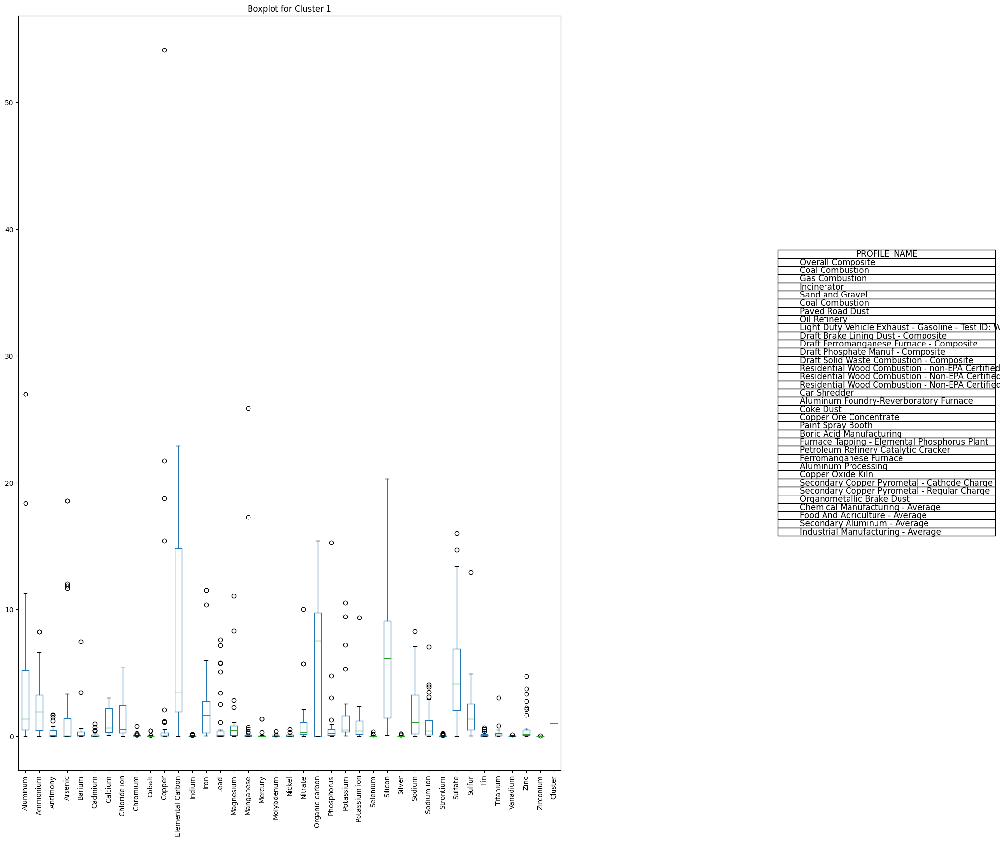

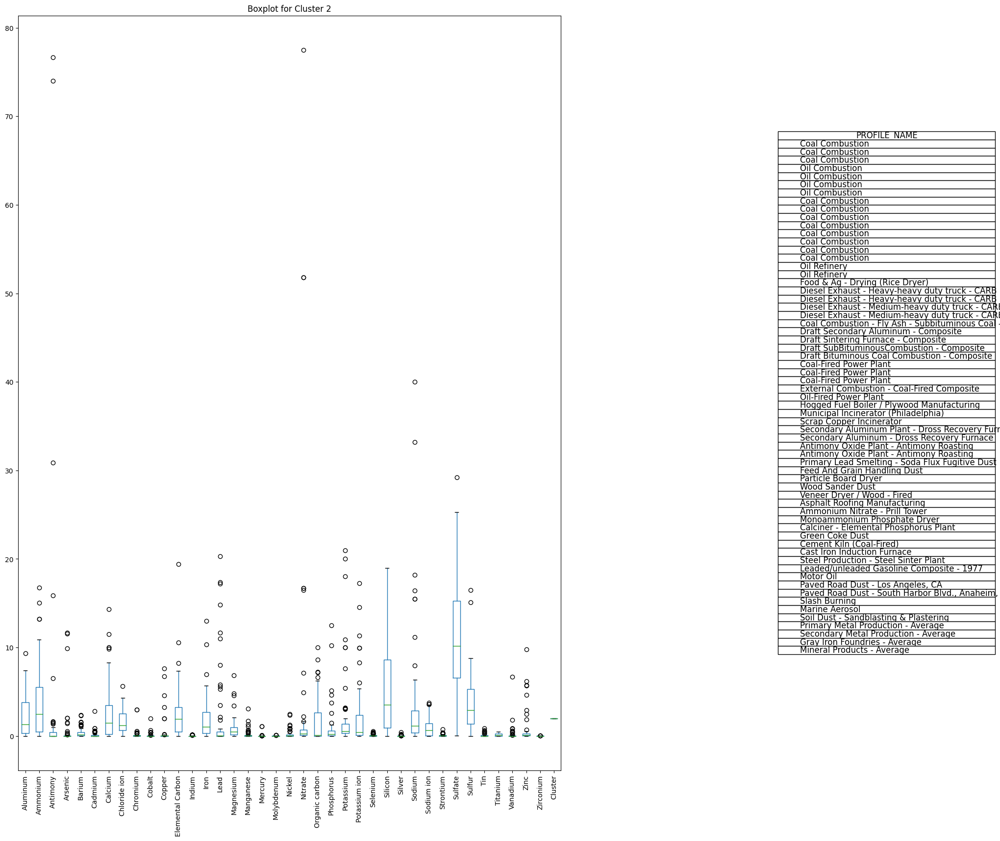

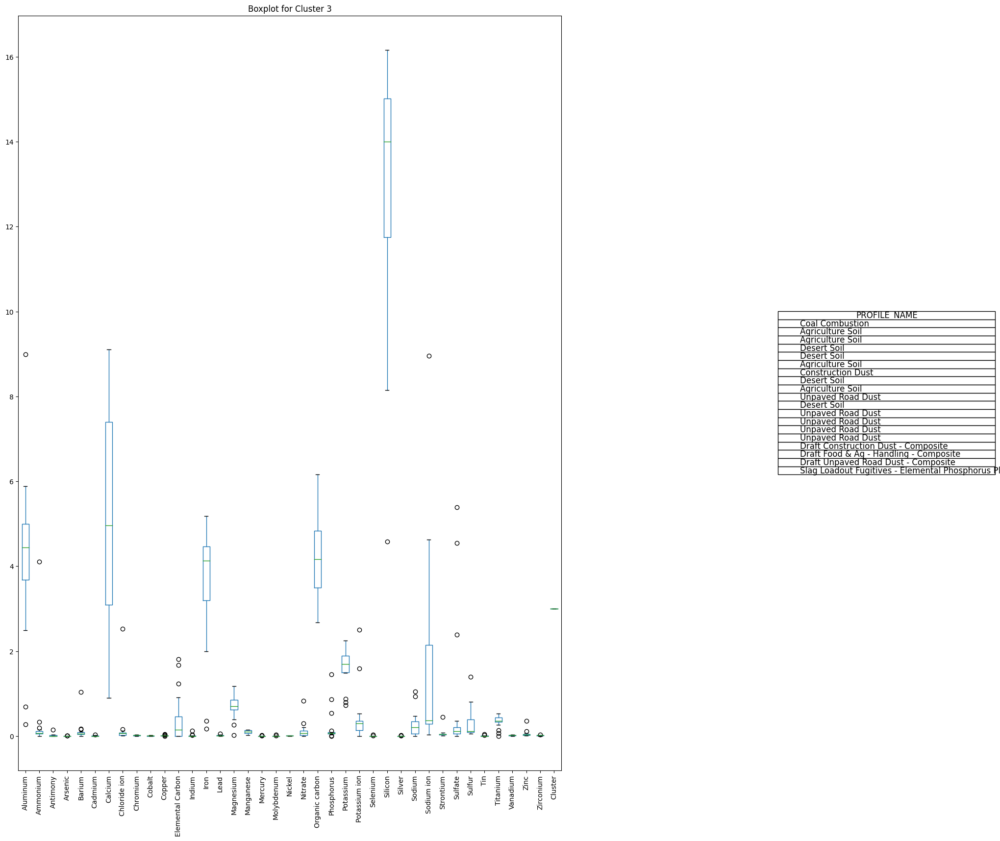

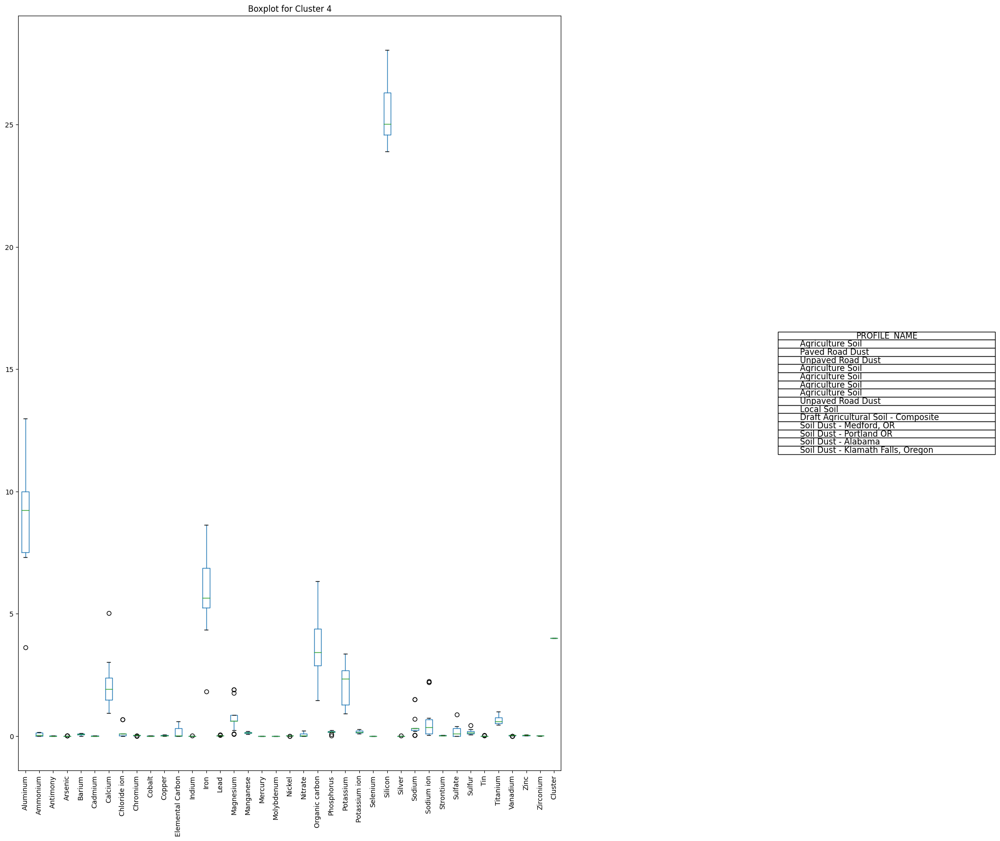

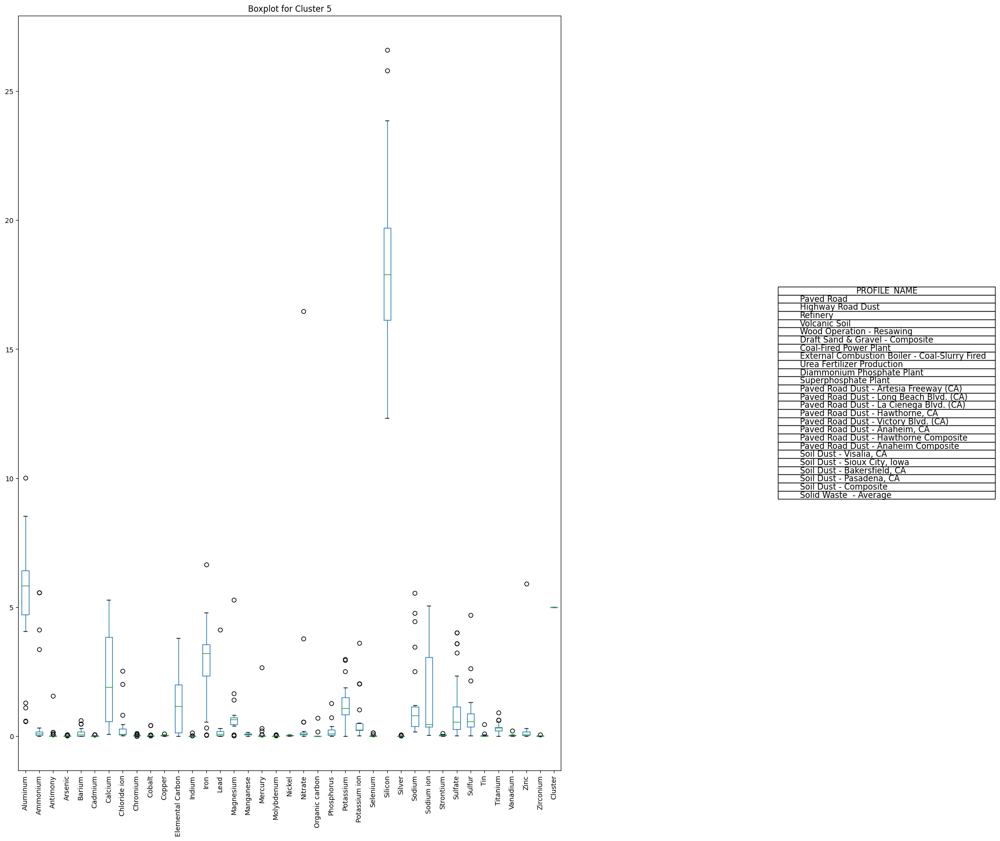

...

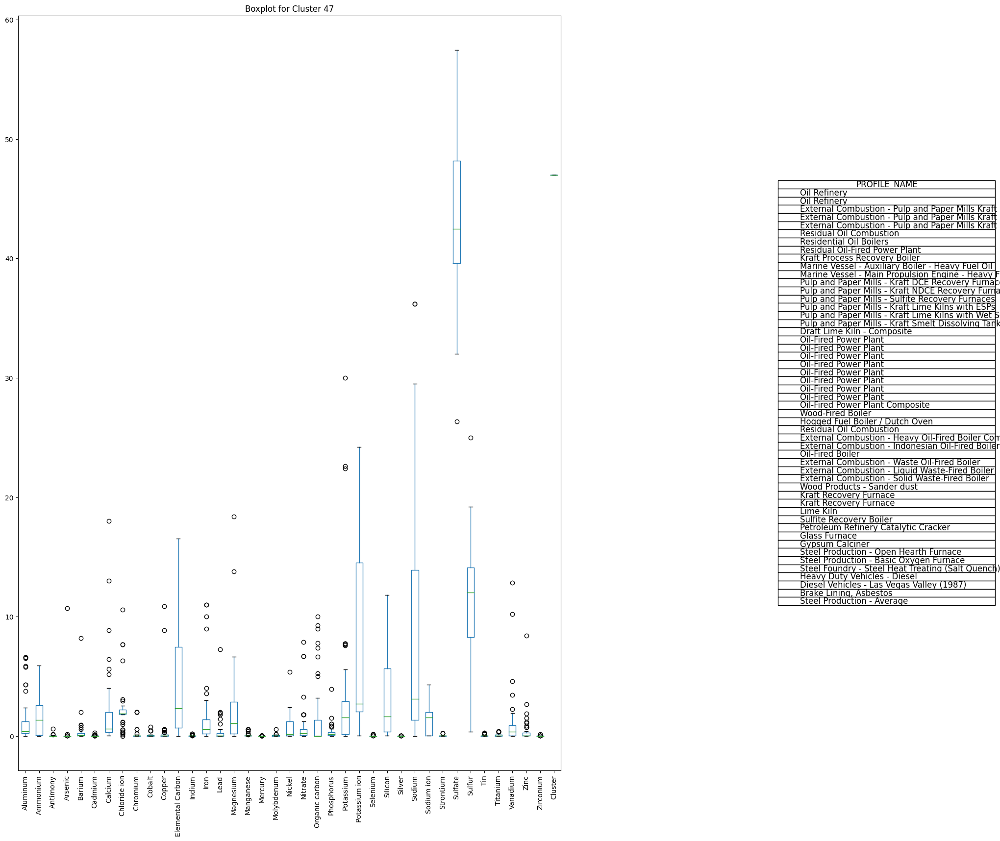

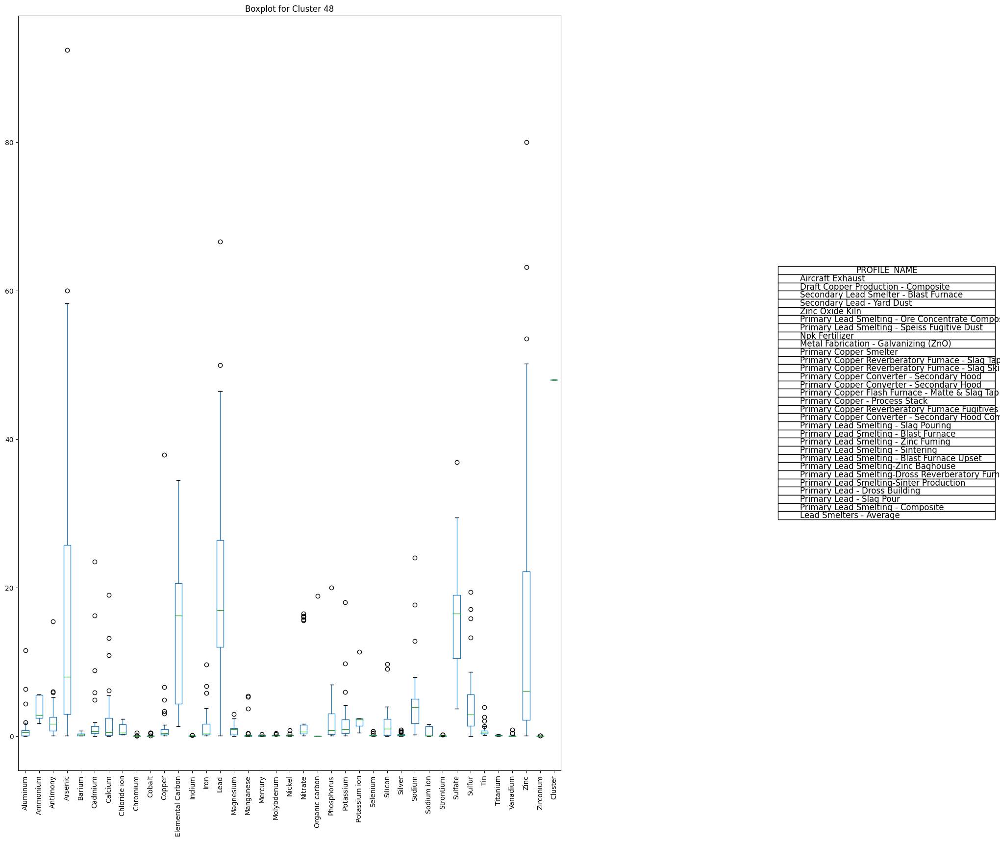

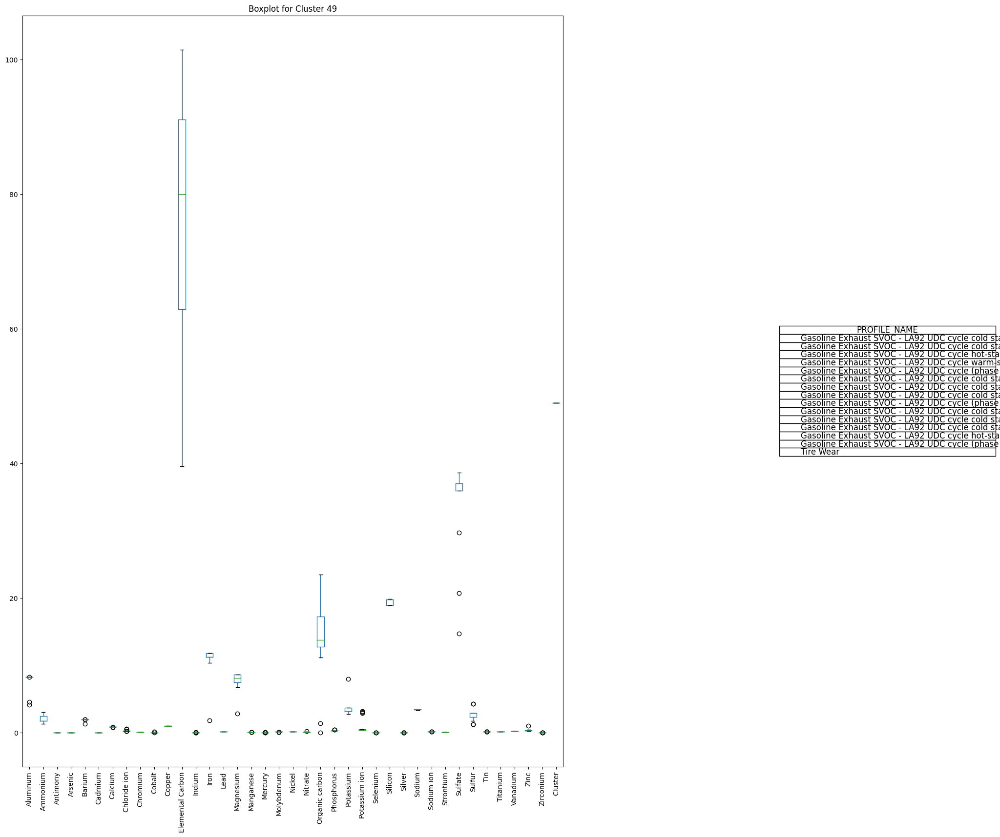

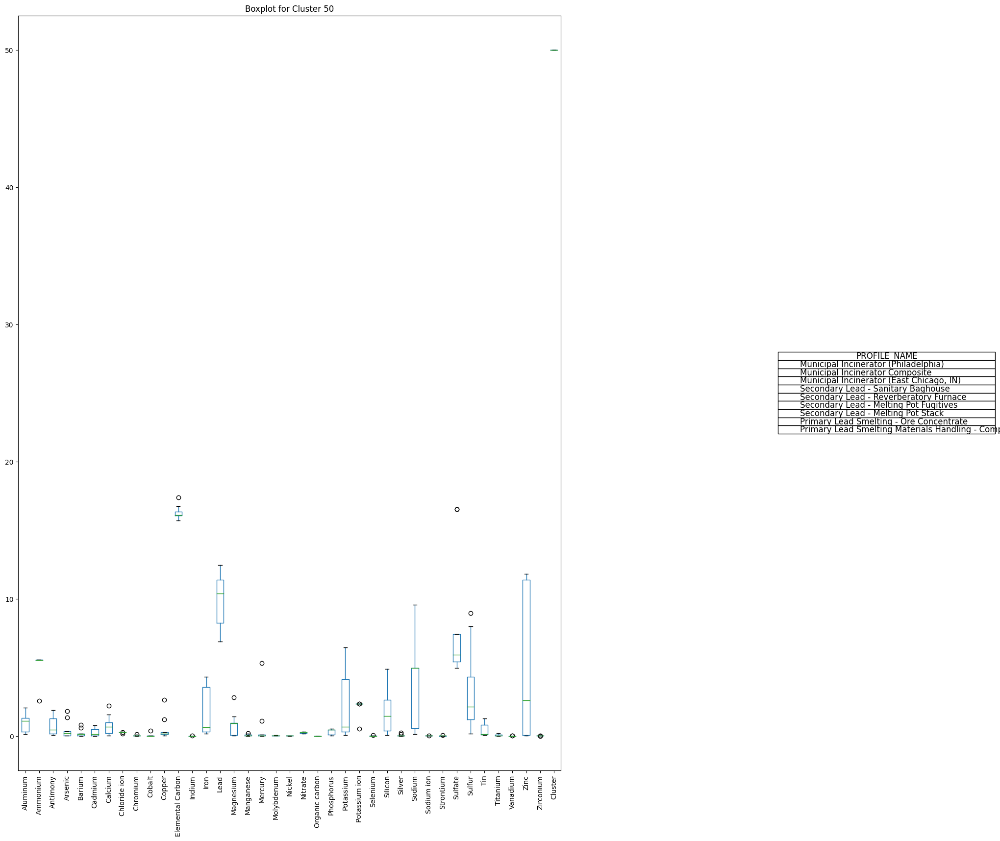

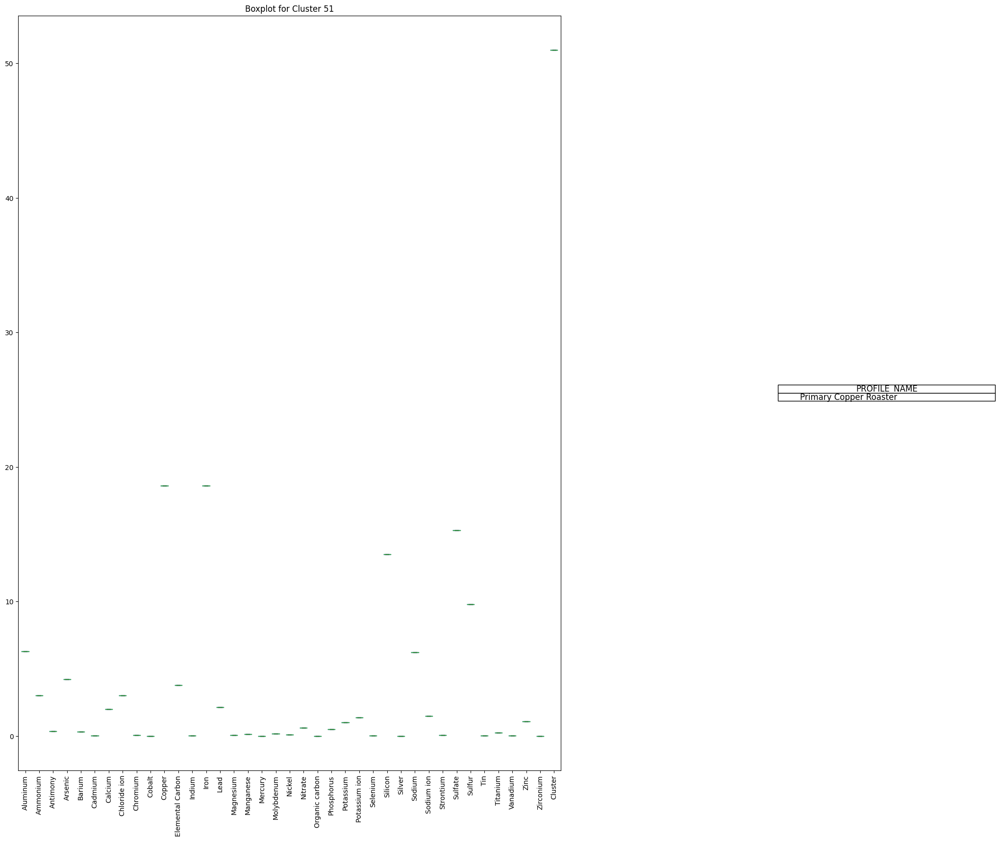

In [37]:
# Get unique cluster numbers
unique_clusters = df['Cluster'].unique()

for cluster_num in sorted(unique_clusters):
    # Get rows belonging to this cluster
    cluster_rows = df[df['Cluster'] == cluster_num]
    
    # Skip if cluster is empty (or handle NaN if present)
    if len(cluster_rows) == 0:
        continue
    
    fig, ax = plt.subplots(figsize=(20, 20))
    
    # Select columns for boxplot (adjust 2:45 as needed)
    boxplot_data = cluster_rows.iloc[:, 6:]
    boxplot_data.boxplot(ax=ax, grid=False)
    ax.grid(False)
    
    plt.title(f"Boxplot for Cluster {cluster_num}")
    plt.xticks(rotation=90)
    
    # Create table area
    divider = make_axes_locatable(ax)
    ax_table = divider.append_axes("right", size="40%", pad=0.0)
    ax_table.axis('off')
    
    # Create table - adjust 'PROFILE_NAME' to your actual column name
    table_data = cluster_rows[['PROFILE_NAME']]
    table = ax_table.table(
        cellText=table_data.values,
        colLabels=table_data.columns,
        cellLoc='left',
        loc='right'
    )
    table.auto_set_font_size(False)
    table.set_fontsize(12)
#     table.scale(2, 2)
    
#     plt.tight_layout()
    plt.show()

In [38]:
df.columns

Index(['Unnamed: 0', 'PROFILE_CODE', 'PROFILE_NAME', 'SCC1', 'SCC2', 'SCC3',
       'Aluminum', 'Ammonium', 'Antimony', 'Arsenic', 'Barium', 'Cadmium',
       'Calcium', 'Chloride ion', 'Chromium', 'Cobalt', 'Copper',
       'Elemental Carbon', 'Indium', 'Iron', 'Lead', 'Magnesium', 'Manganese',
       'Mercury', 'Molybdenum', 'Nickel', 'Nitrate', 'Organic carbon',
       'Phosphorus', 'Potassium', 'Potassium ion', 'Selenium', 'Silicon',
       'Silver', 'Sodium', 'Sodium ion', 'Strontium', 'Sulfate', 'Sulfur',
       'Tin', 'Titanium', 'Vanadium', 'Zinc', 'Zirconium', 'Cluster'],
      dtype='object')

In [39]:
# Define metal and non-metal elements
metal_elements = [
    'Aluminum', 'Antimony', 'Arsenic', 'Barium', 'Cadmium', 'Calcium',
    'Chromium', 'Cobalt', 'Copper', 'Indium', 'Iron', 'Lead', 'Magnesium',
    'Manganese', 'Mercury', 'Molybdenum', 'Nickel', 'Silver', 'Sodium',
    'Strontium', 'Tin', 'Titanium', 'Vanadium', 'Zinc', 'Zirconium'
]

non_metal_elements = [
    'Ammonium', 'Chloride ion', 'Elemental Carbon', 'Nitrate', 'Organic carbon',
    'Phosphorus', 'Potassium', 'Potassium ion', 'Selenium', 'Silicon',
    'Sodium ion', 'Sulfate', 'Sulfur'
]

In [40]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_boxplot(df, cluster_num, element_list, title_suffix):
    """Plots a boxplot for a given cluster and element list."""
    cluster_rows = df[df['Cluster'] == cluster_num]
    
    # Skip if cluster is empty
    if len(cluster_rows) == 0:
        return
    
    # Select only the relevant columns
    boxplot_data = cluster_rows[element_list]
    
    fig, ax = plt.subplots(figsize=(15, 8))
    boxplot_data.boxplot(ax=ax, grid=False)
    ax.grid(False)
    
    plt.title(f"Boxplot for Cluster {cluster_num} ({title_suffix})")
    plt.xticks(rotation=90)
    
    # Create table area
    divider = make_axes_locatable(ax)
    ax_table = divider.append_axes("right", size="40%", pad=0.0)
    ax_table.axis('off')
    
    # Display profile names for reference
    table_data = cluster_rows[['PROFILE_NAME']]
    table = ax_table.table(
        cellText=table_data.values,
        colLabels=table_data.columns,
        cellLoc='left',
        loc='right'
    )
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    
    plt.show()

# Get unique cluster numbers
unique_clusters = df['Cluster'].unique()

## Metal

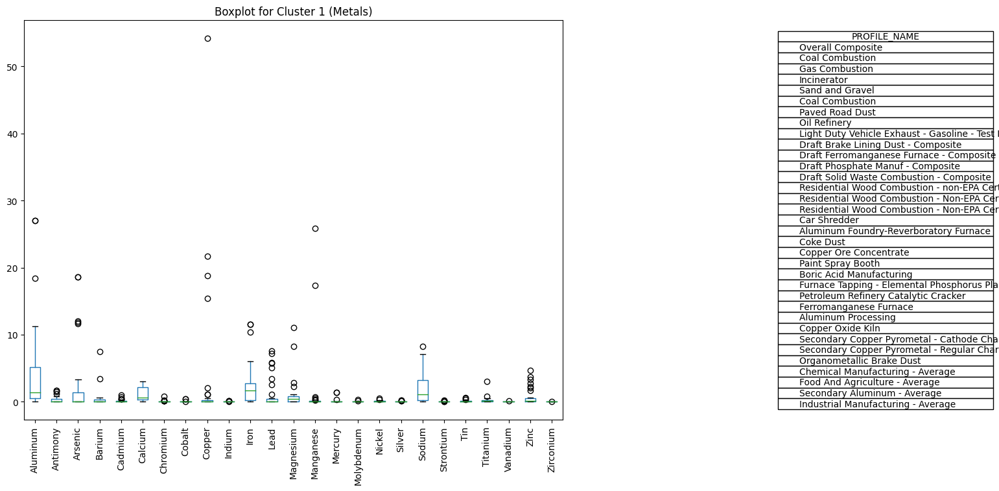

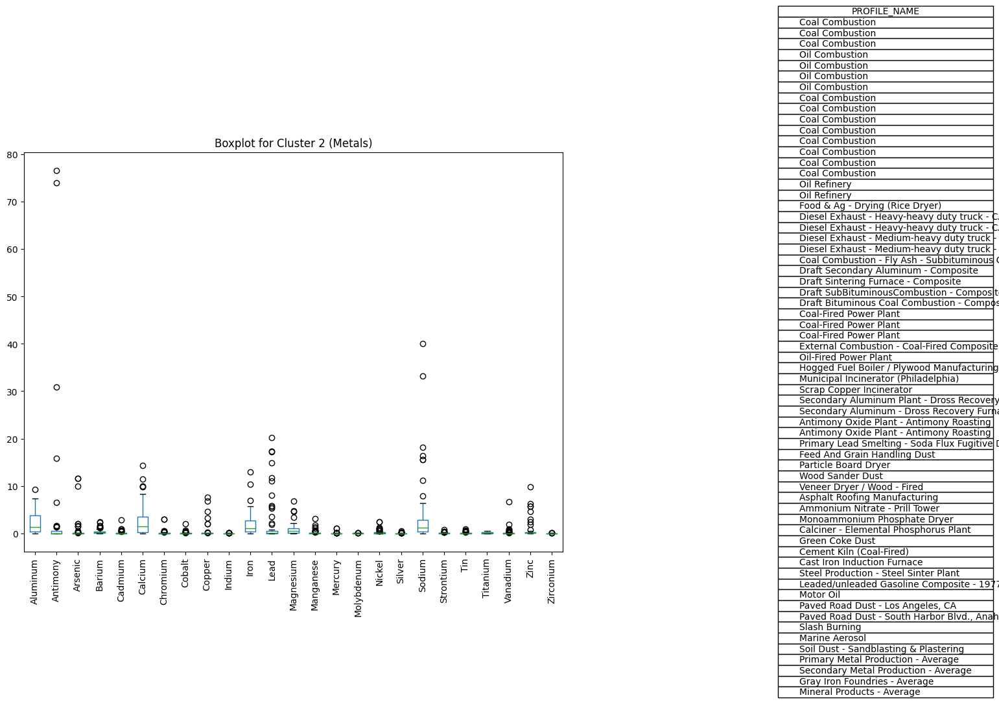

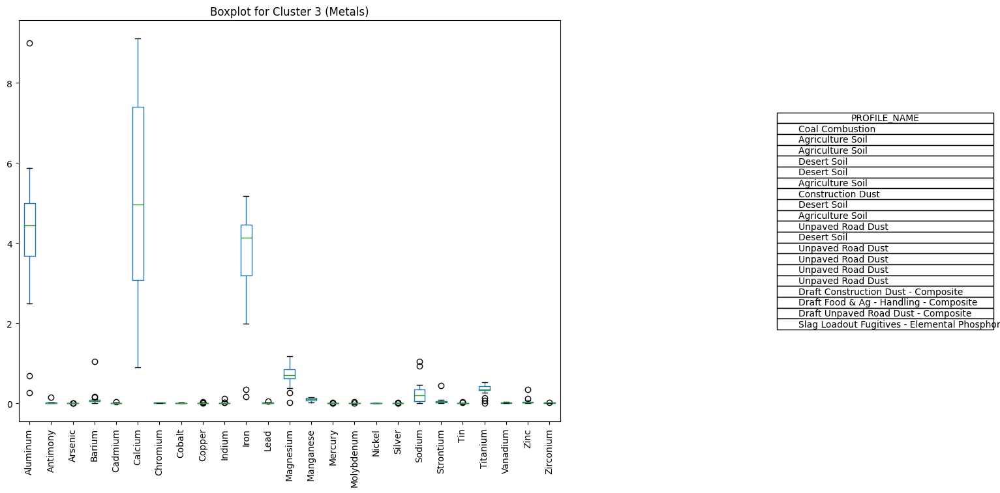

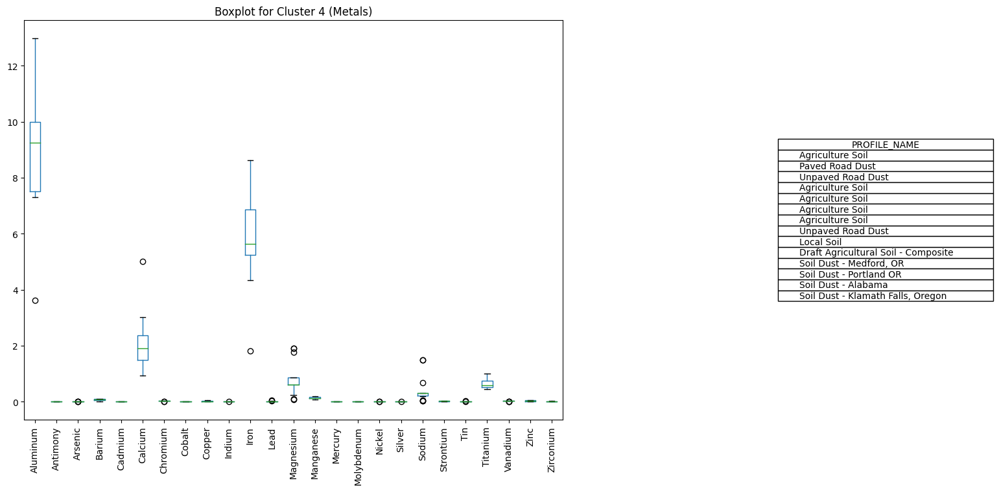

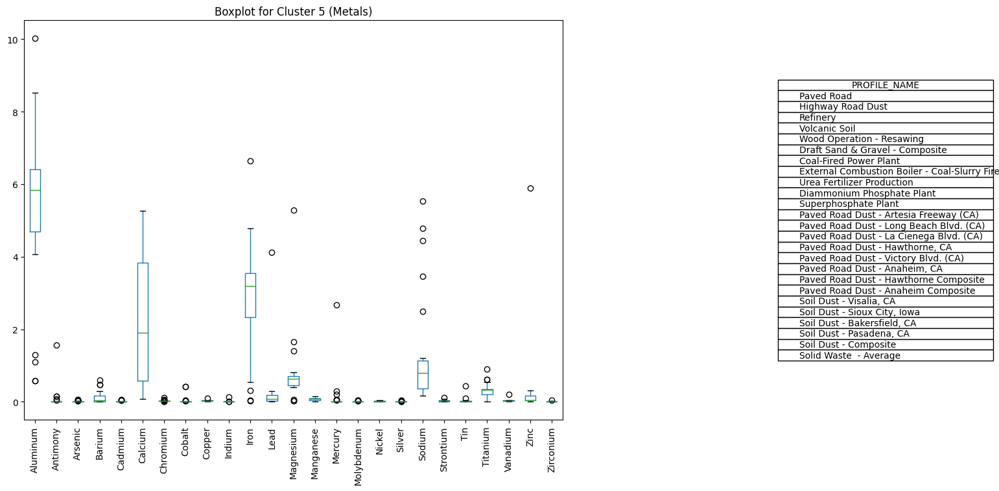

...

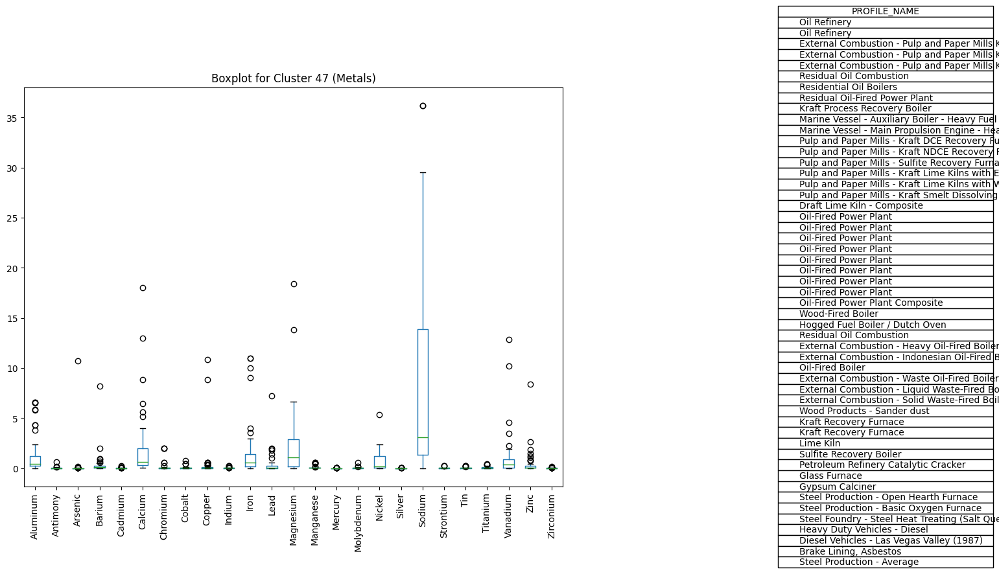

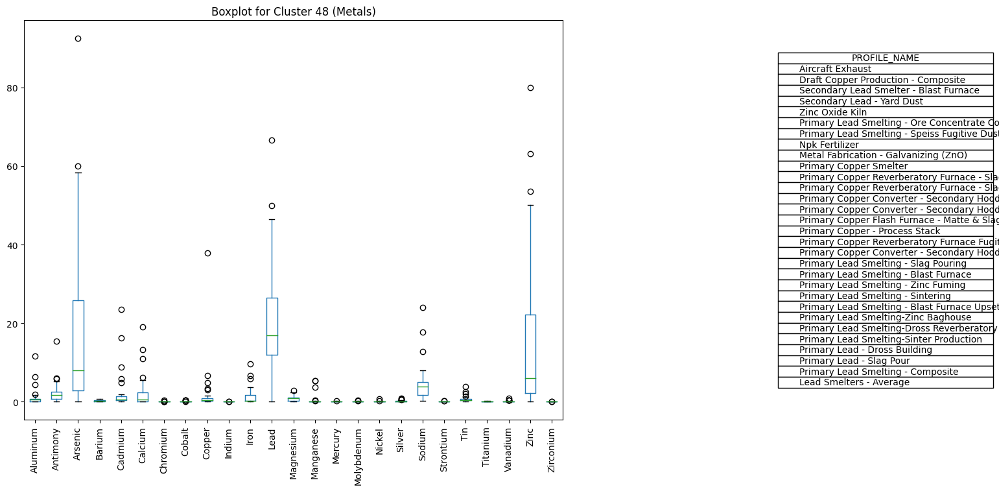

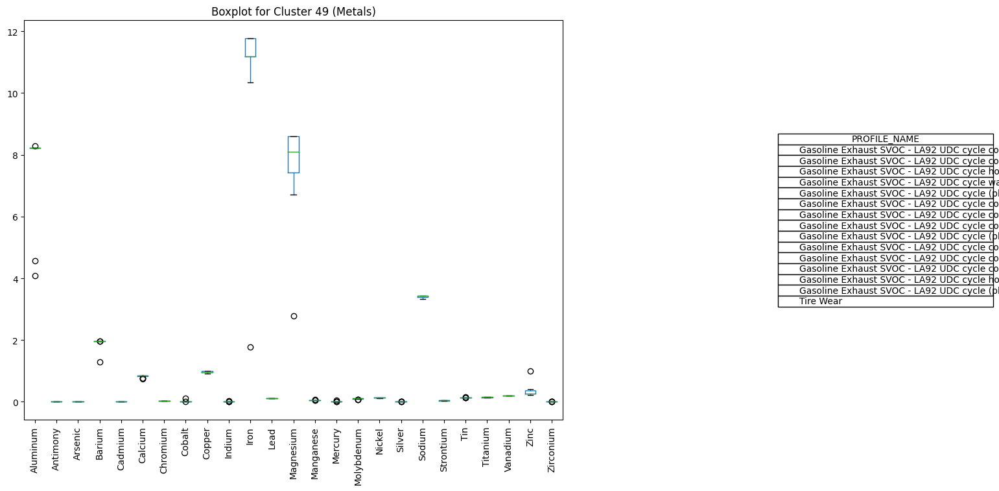

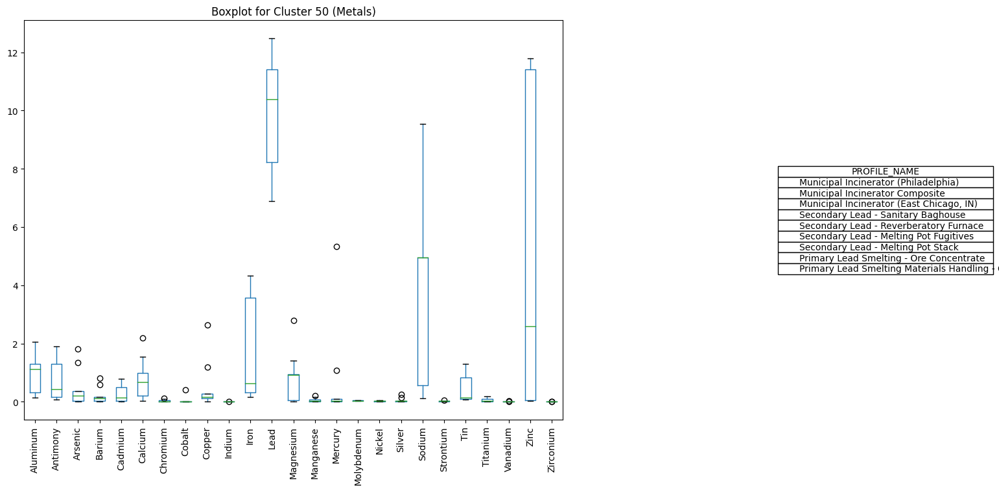

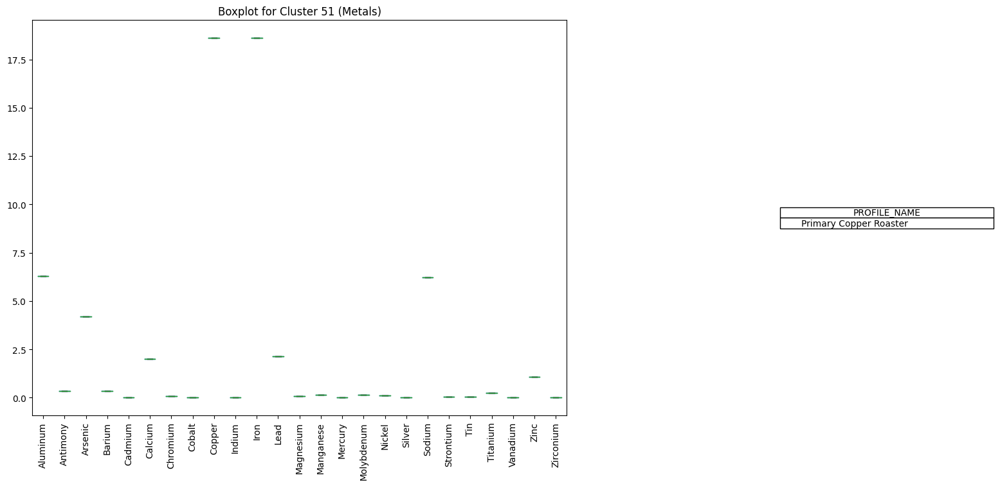

In [41]:
for cluster_num in sorted(unique_clusters):
    plot_boxplot(df, cluster_num, metal_elements, "Metals")
#     plot_boxplot(df, cluster_num, non_metal_elements, "Non-Metals")


## Non Metal

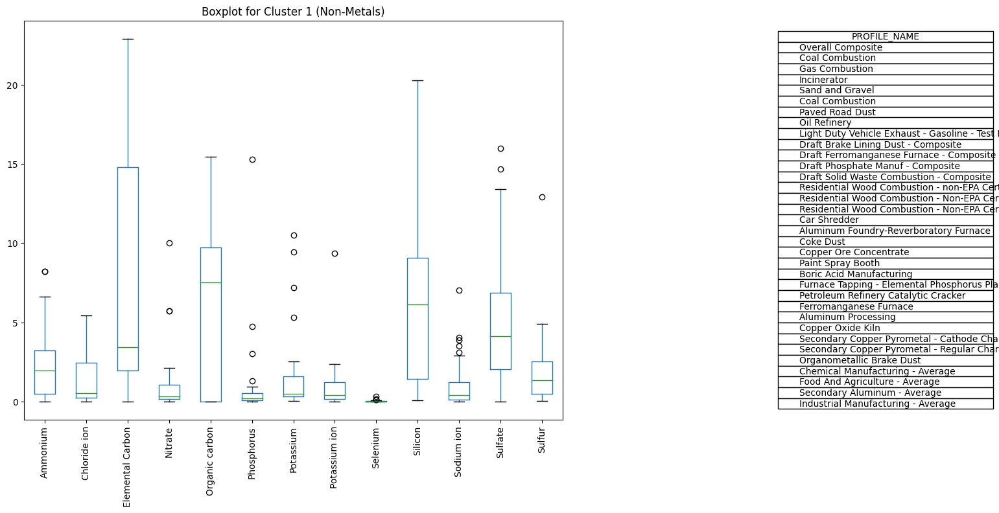

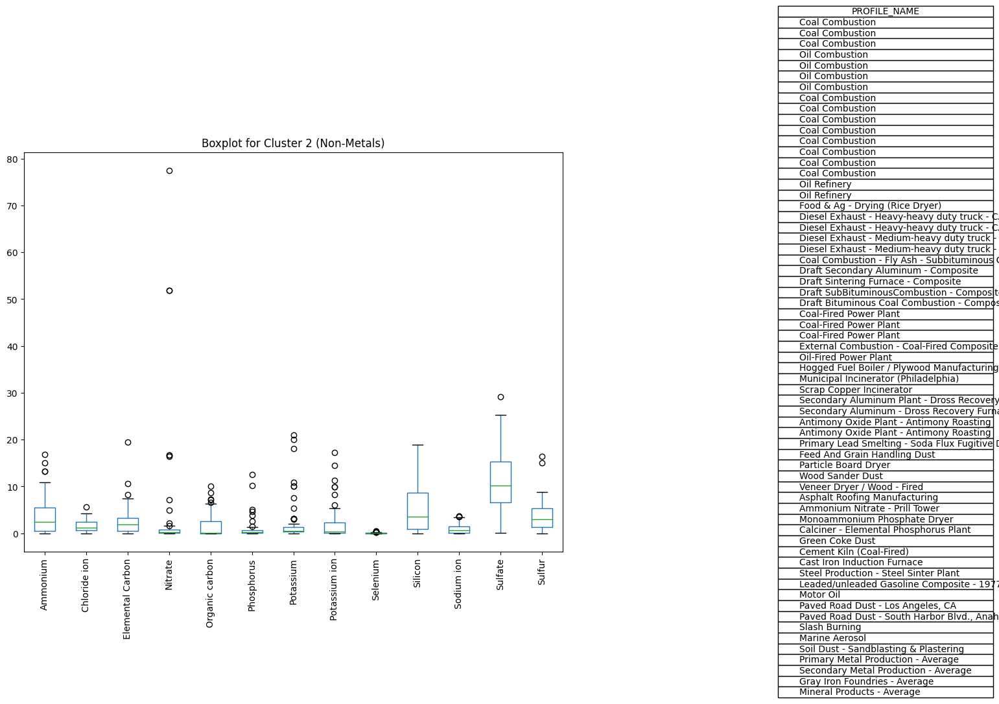

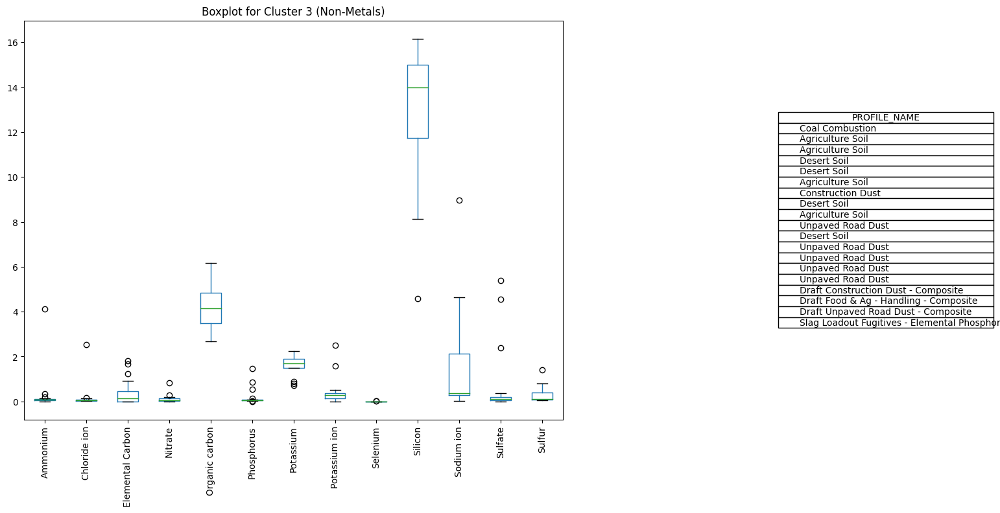

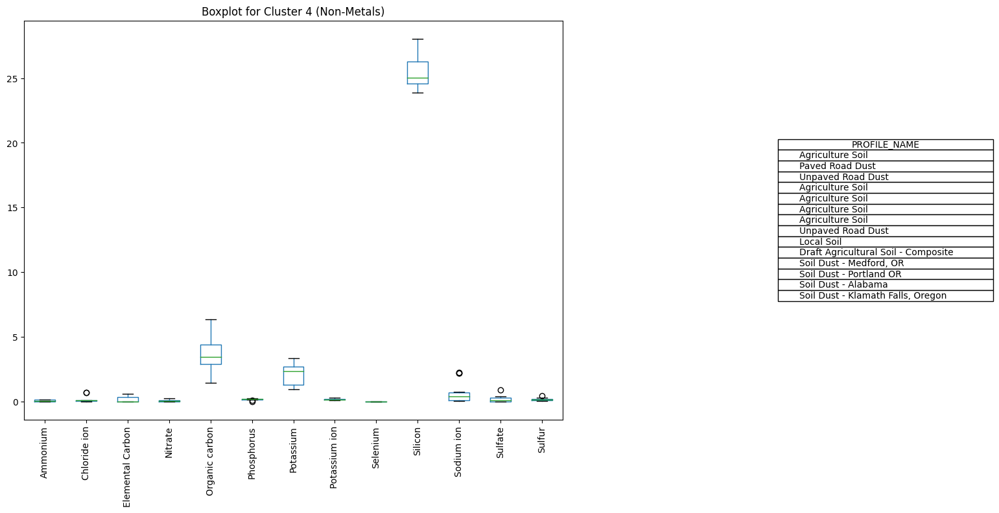

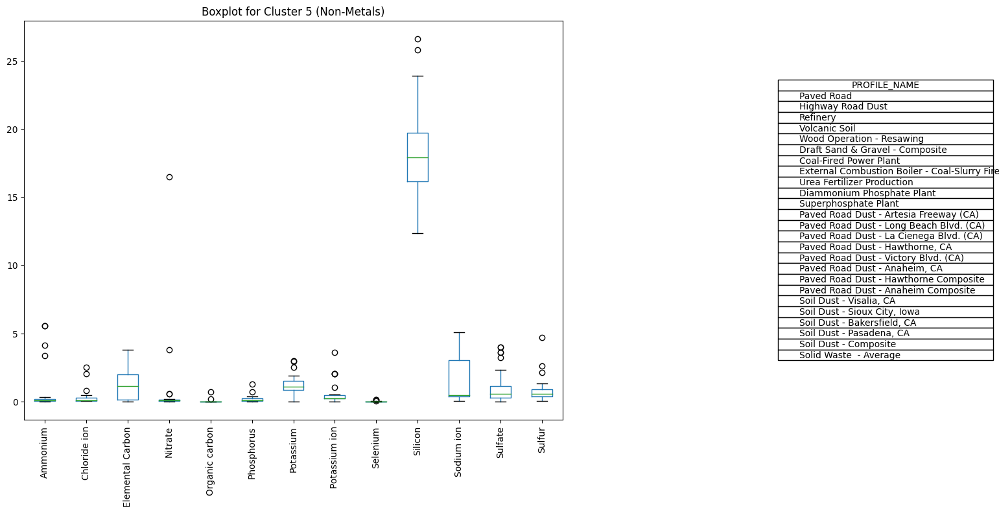

...

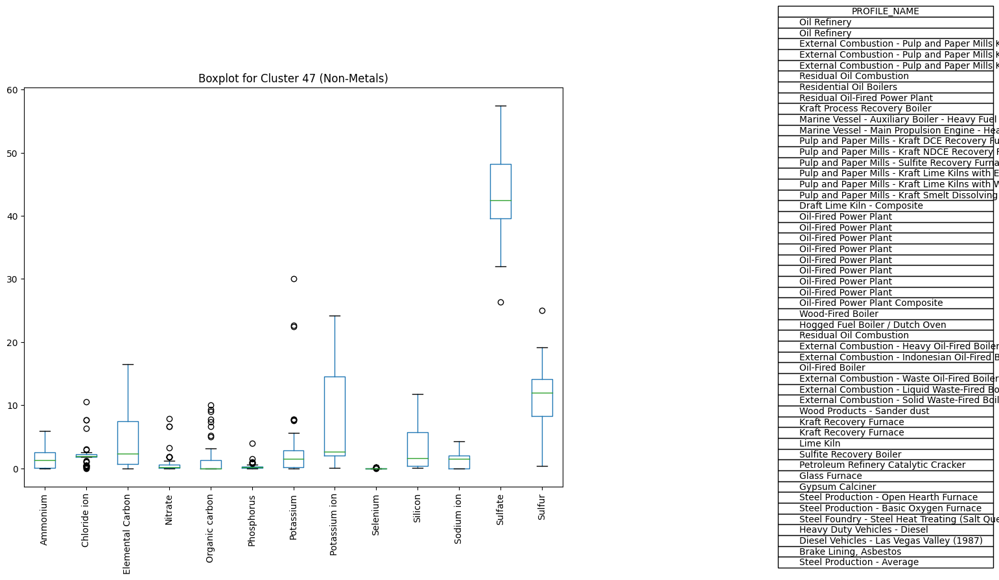

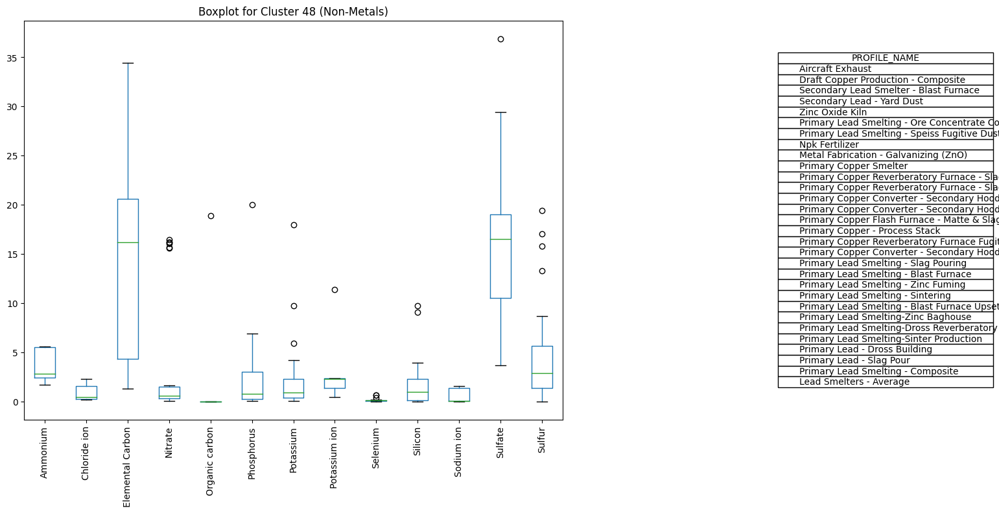

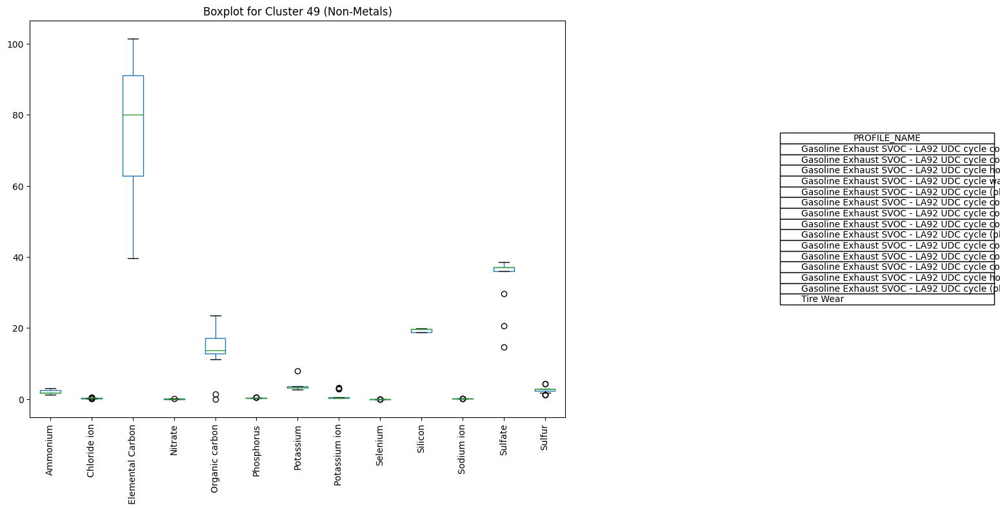

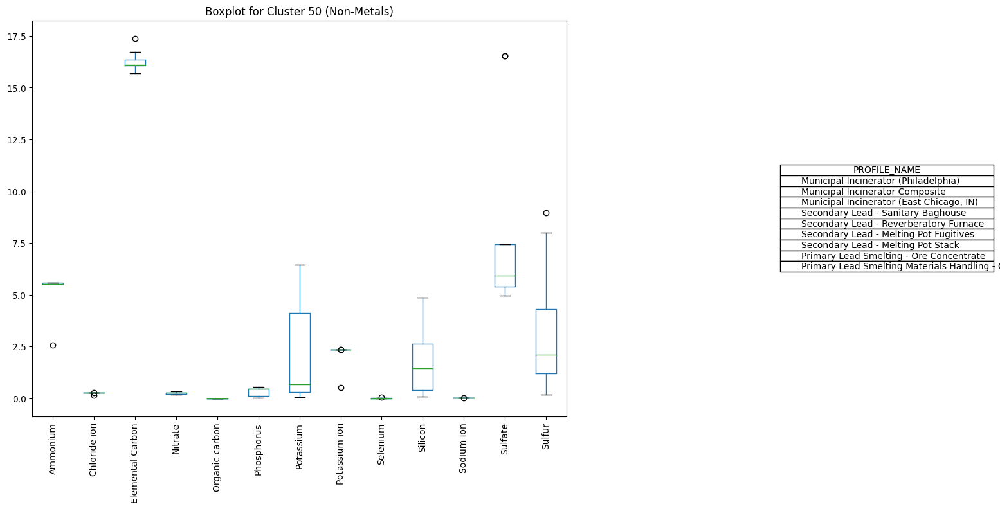

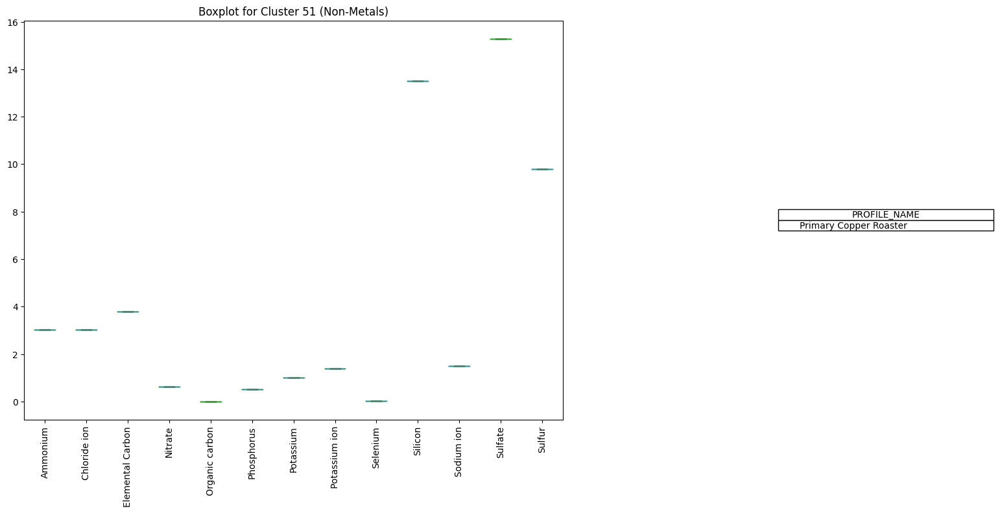

In [42]:
for cluster_num in sorted(unique_clusters):
#     plot_boxplot(df, cluster_num, metal_elements, "Metals")
    plot_boxplot(df, cluster_num, non_metal_elements, "Non-Metals")


# Top K important species

Important species for Cluster 1: ['Copper', 'Elemental Carbon', 'Organic carbon', 'Aluminum', 'Silicon']


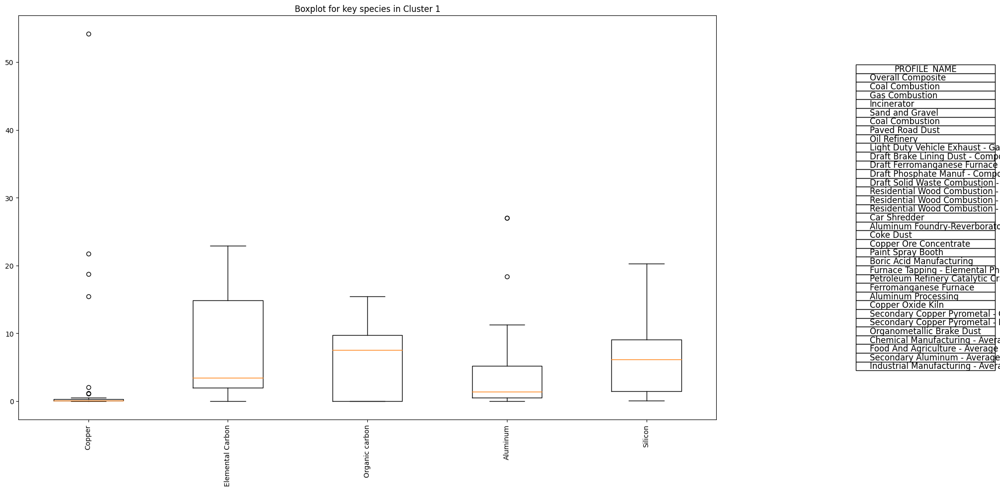

Important species for Cluster 2: ['Antimony', 'Nitrate', 'Sulfate', 'Sodium', 'Silicon']


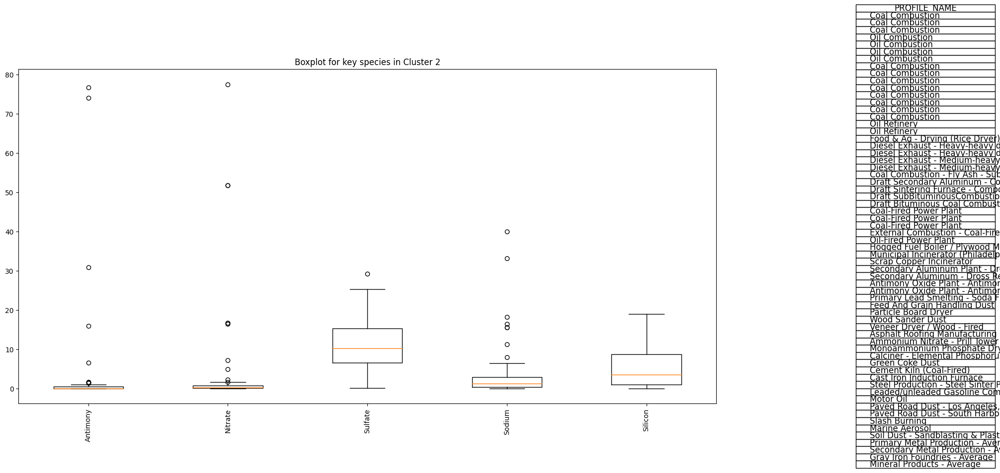

Important species for Cluster 3: ['Silicon', 'Calcium', 'Sodium ion', 'Aluminum', 'Organic carbon']


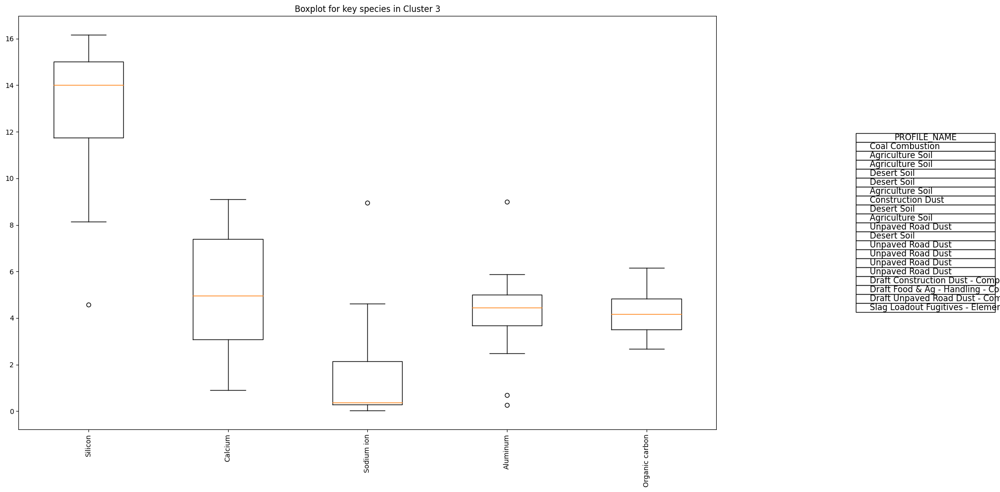

Important species for Cluster 4: ['Silicon', 'Aluminum', 'Iron', 'Organic carbon', 'Calcium']


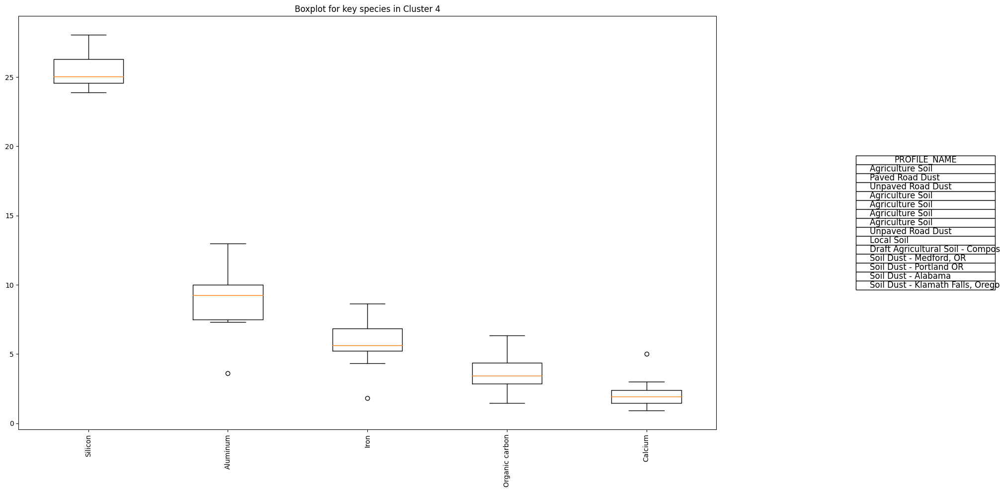

Important species for Cluster 5: ['Silicon', 'Aluminum', 'Nitrate', 'Cluster', 'Iron']


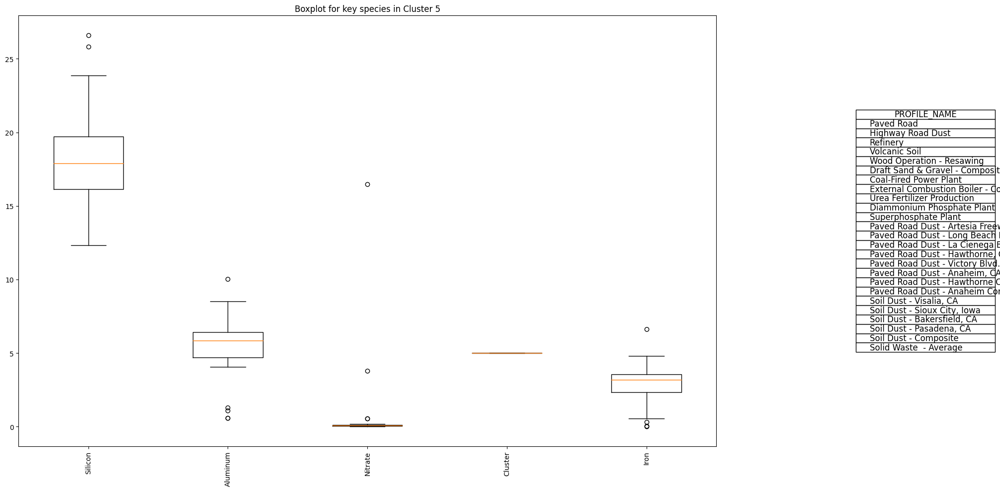

Important species for Cluster 6: ['Silicon', 'Organic carbon', 'Aluminum', 'Cluster', 'Iron']


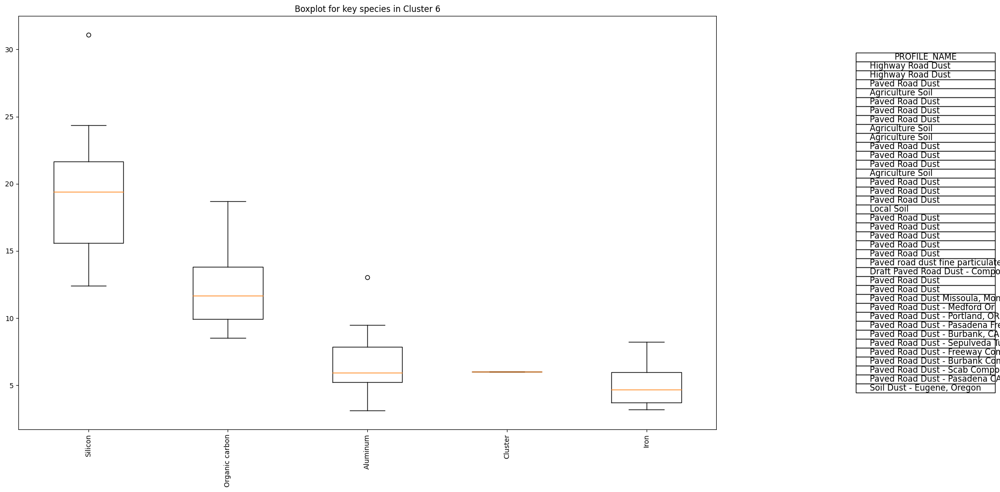

Important species for Cluster 7: ['Silicon', 'Aluminum', 'Iron', 'Sulfate', 'Sulfur']


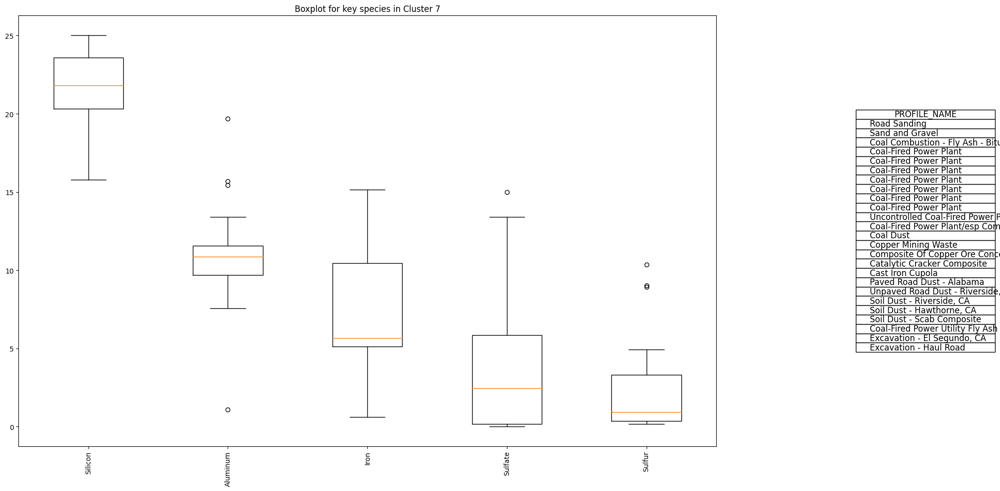

Important species for Cluster 8: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Sulfate', 'Chloride ion']


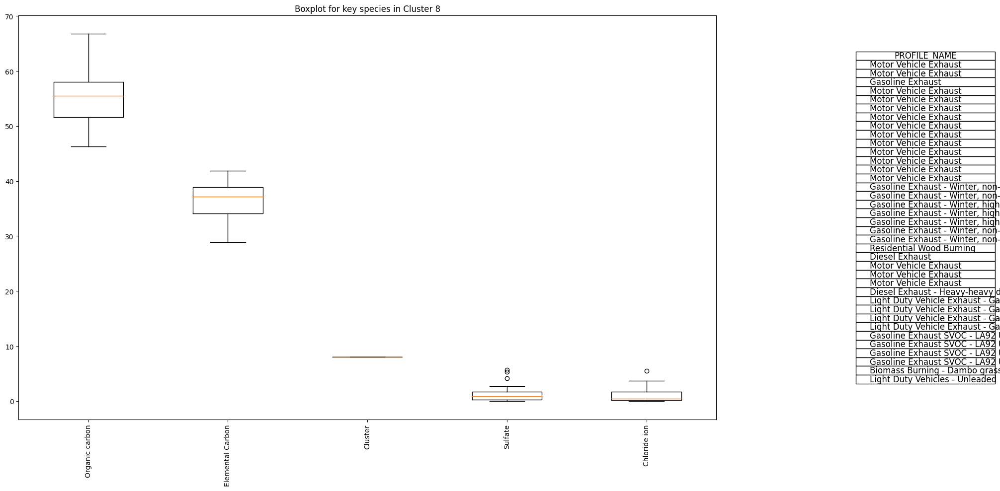

Important species for Cluster 9: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Potassium', 'Sulfate']


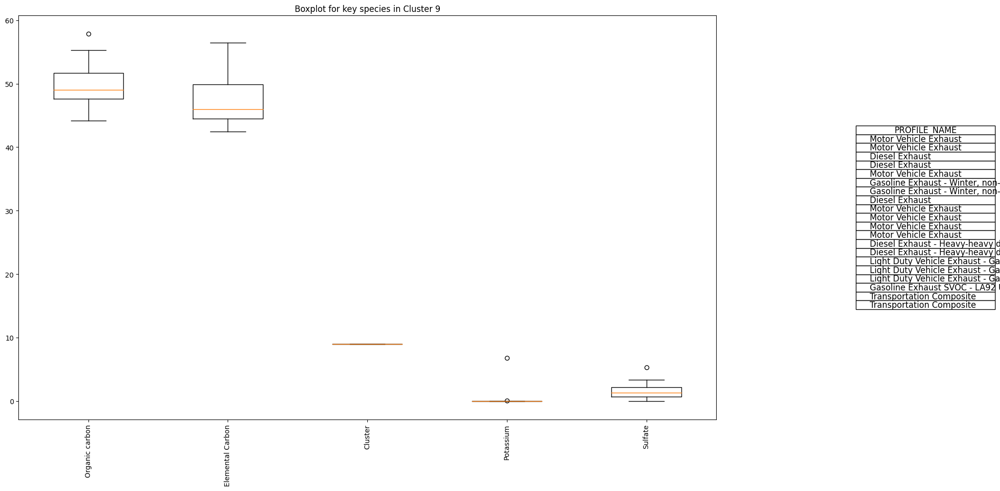

Important species for Cluster 10: ['Elemental Carbon', 'Organic carbon', 'Cluster', 'Arsenic', 'Sulfate']


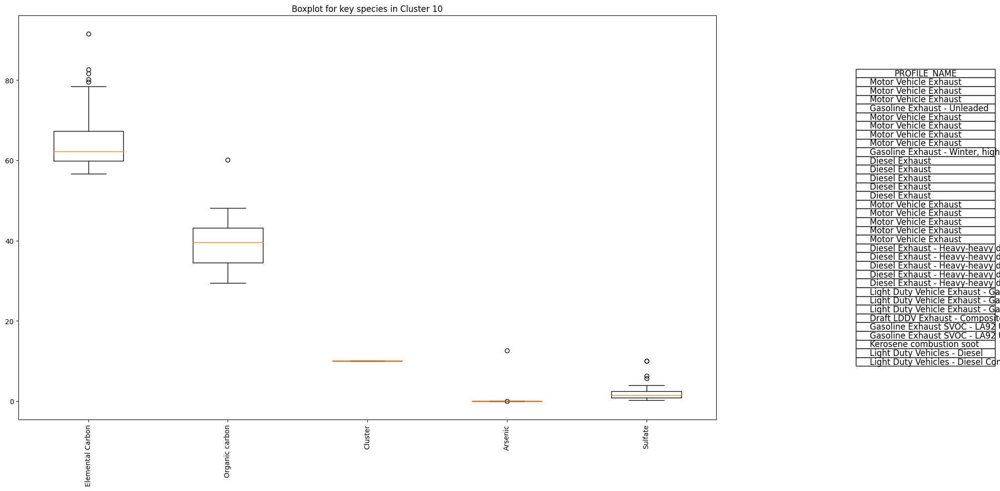

Important species for Cluster 11: ['Elemental Carbon', 'Organic carbon', 'Lead', 'Sulfate', 'Silicon']


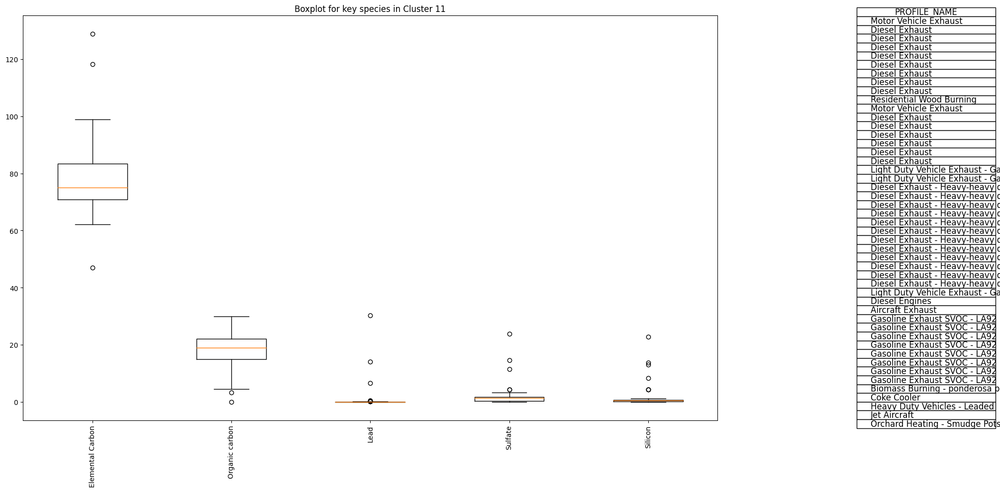

Important species for Cluster 12: ['Organic carbon', 'Elemental Carbon', 'Silicon', 'Cluster', 'Sodium']


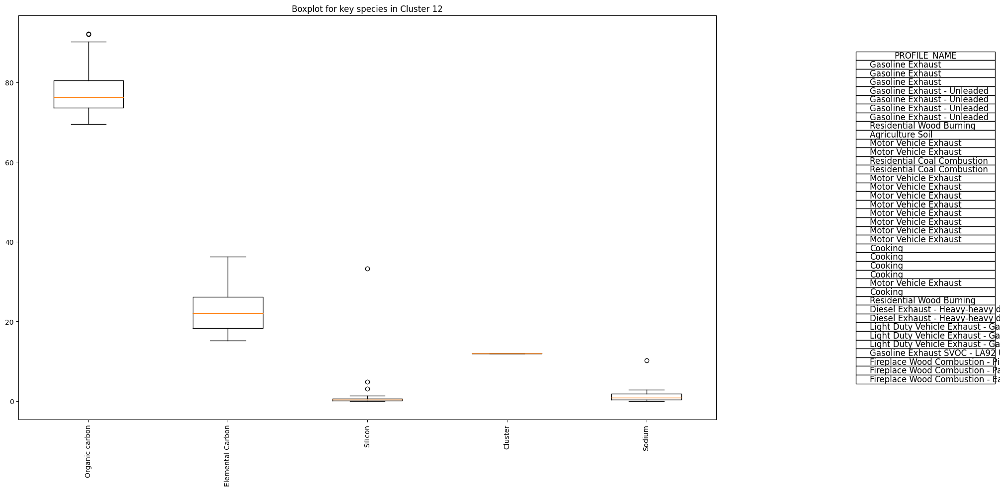

Important species for Cluster 13: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Lead', 'Sulfate']


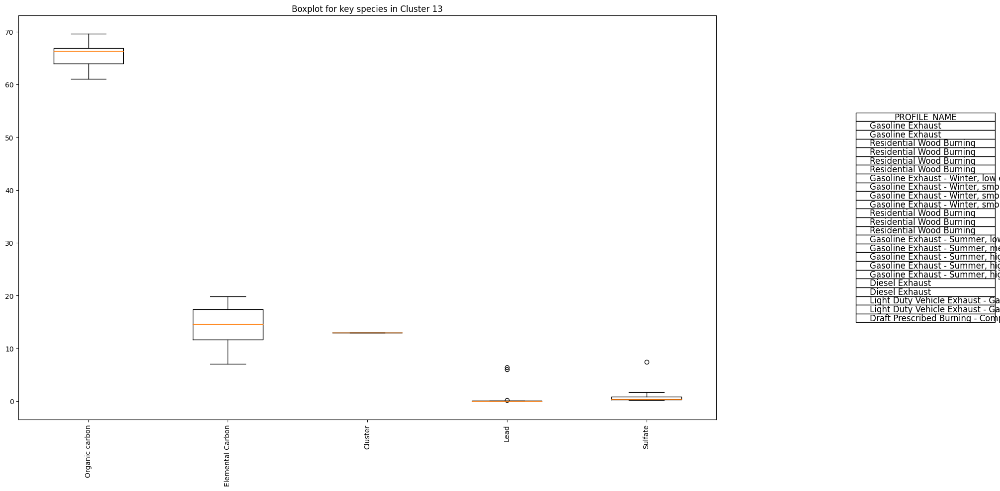

Important species for Cluster 14: ['Elemental Carbon', 'Organic carbon', 'Sulfate', 'Cluster', 'Potassium']


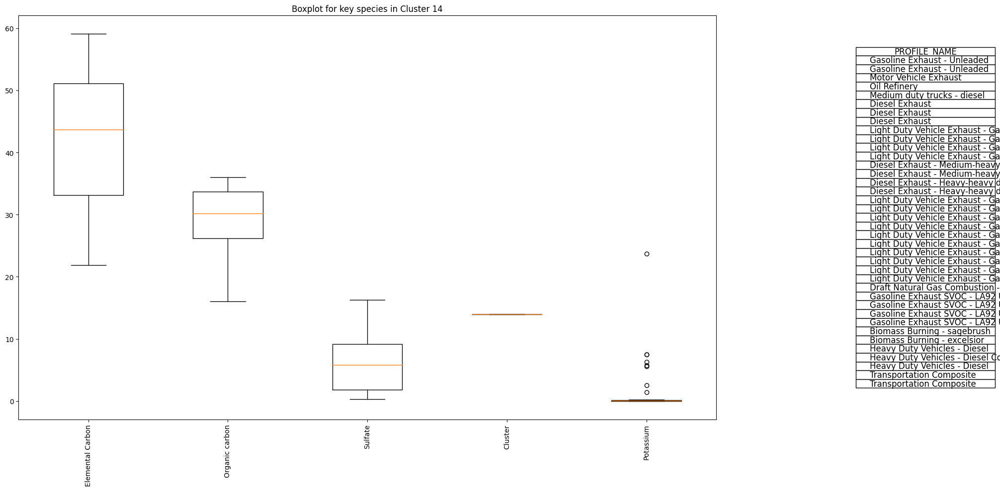

Important species for Cluster 15: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Sulfate', 'Nitrate']


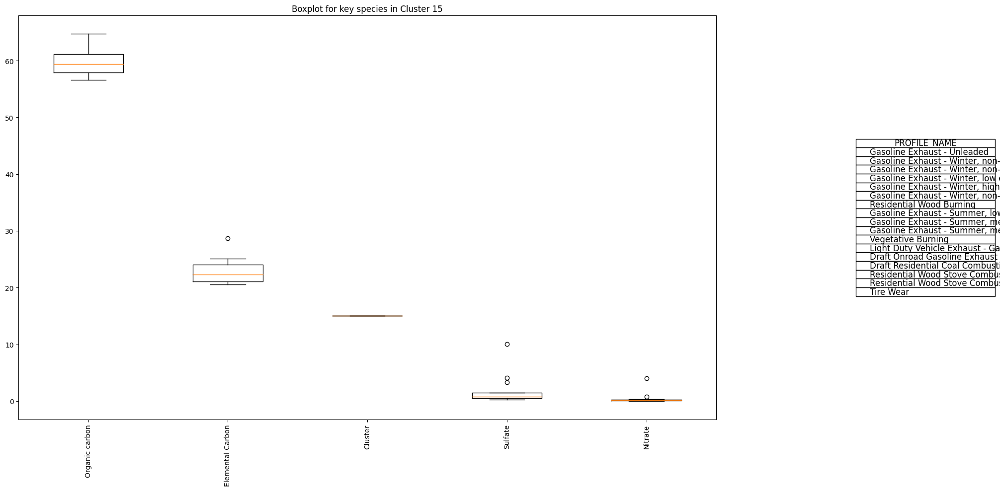

Important species for Cluster 16: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Sulfate', 'Silicon']


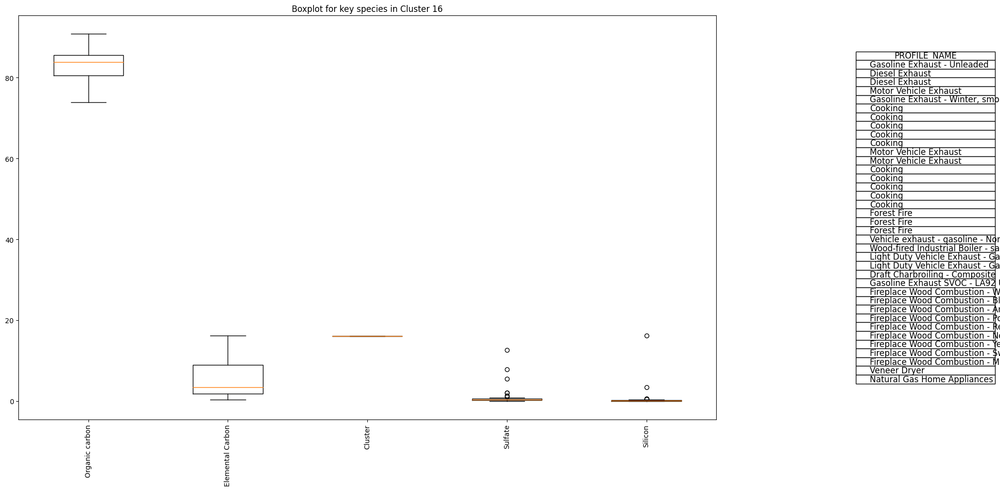

Important species for Cluster 17: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Nitrate', 'Sulfate']


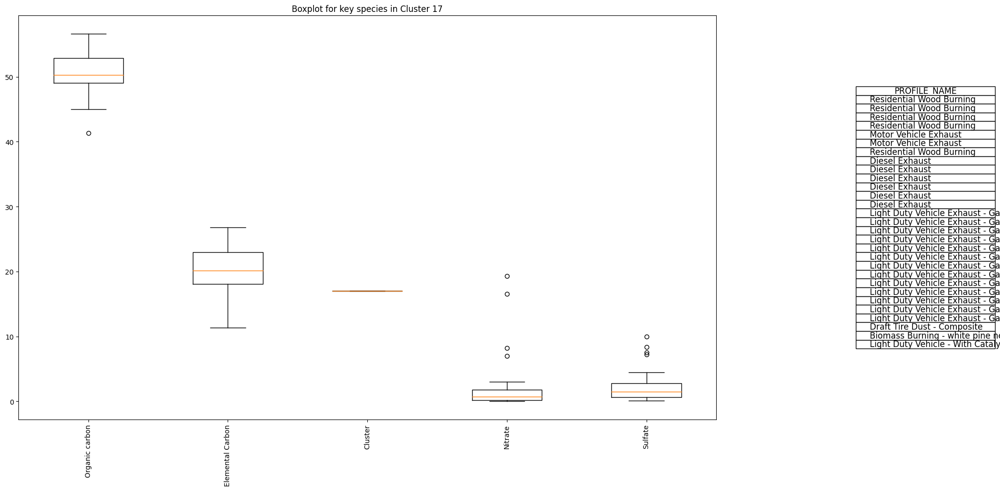

Important species for Cluster 18: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Iron', 'Zinc']


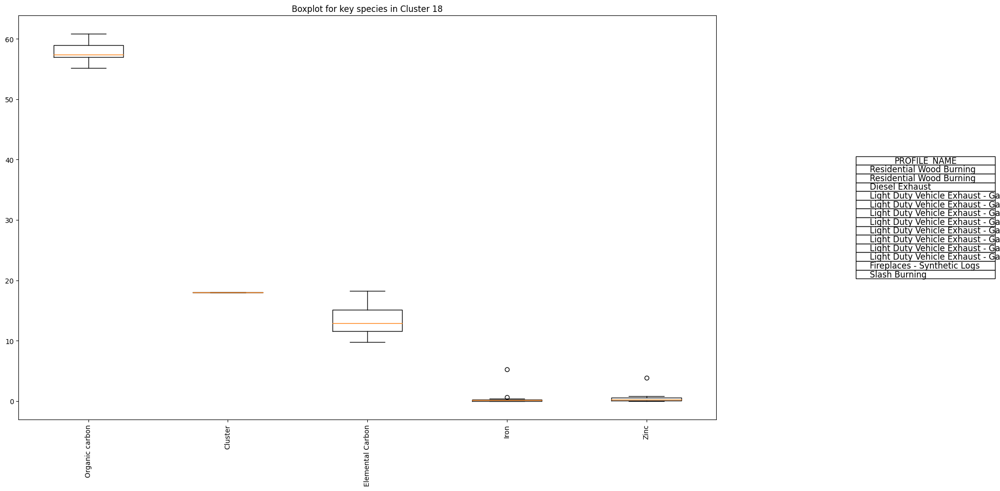

Important species for Cluster 19: ['Organic carbon', 'Sulfate', 'Cluster', 'Lead', 'Elemental Carbon']


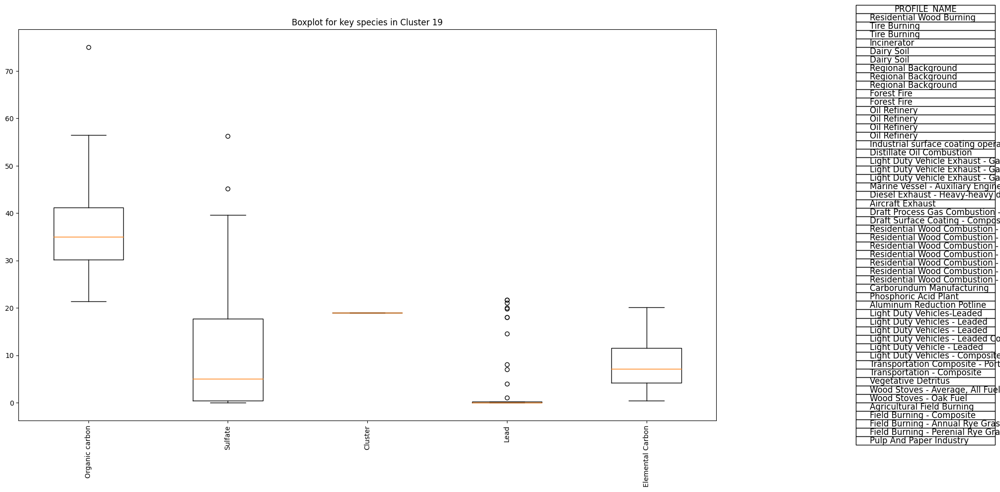

Important species for Cluster 20: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Chloride ion', 'Potassium']


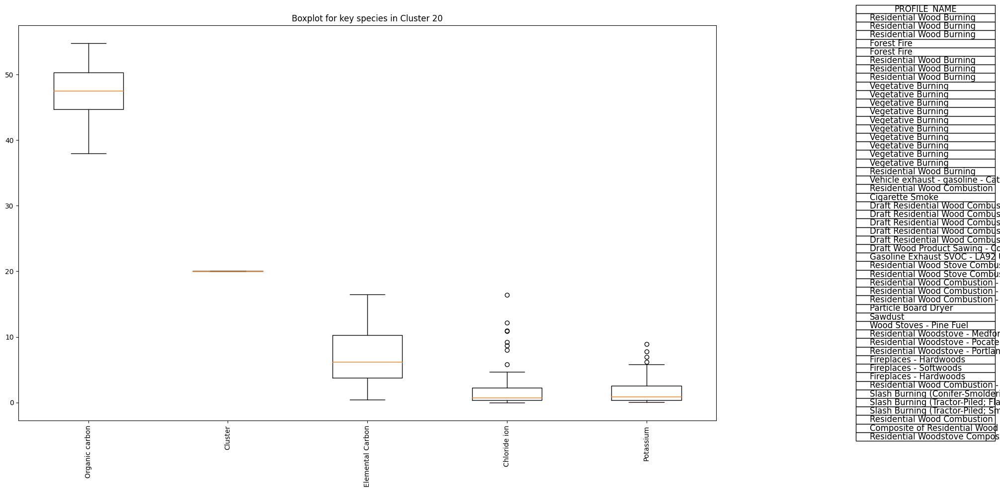

Important species for Cluster 21: ['Organic carbon', 'Cluster', 'Potassium', 'Chloride ion', 'Potassium ion']


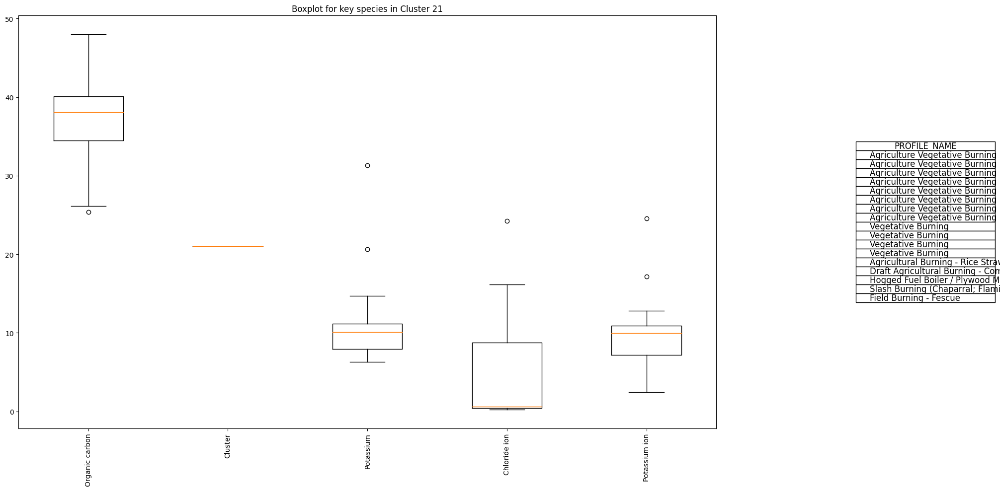

Important species for Cluster 22: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Sulfate', 'Silicon']


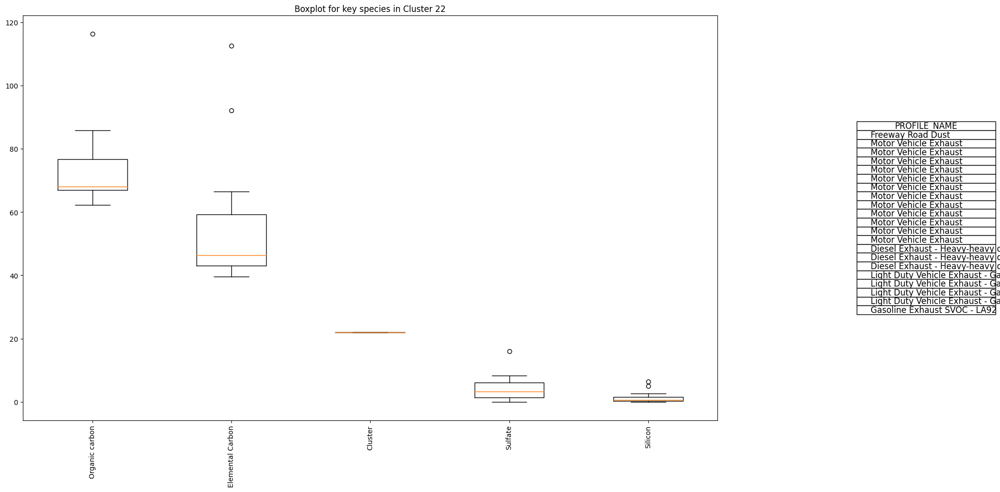

Important species for Cluster 23: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Potassium ion', 'Nitrate']


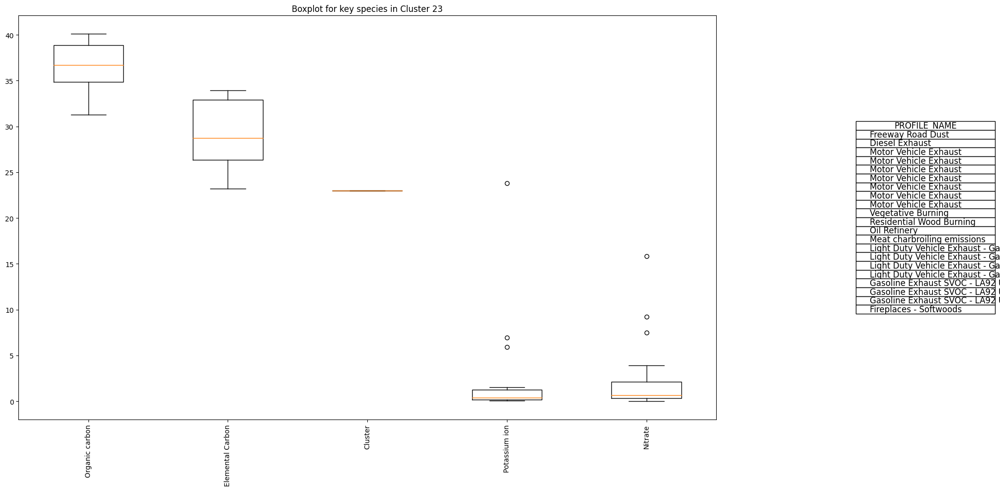

Important species for Cluster 24: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Lead', 'Sulfate']


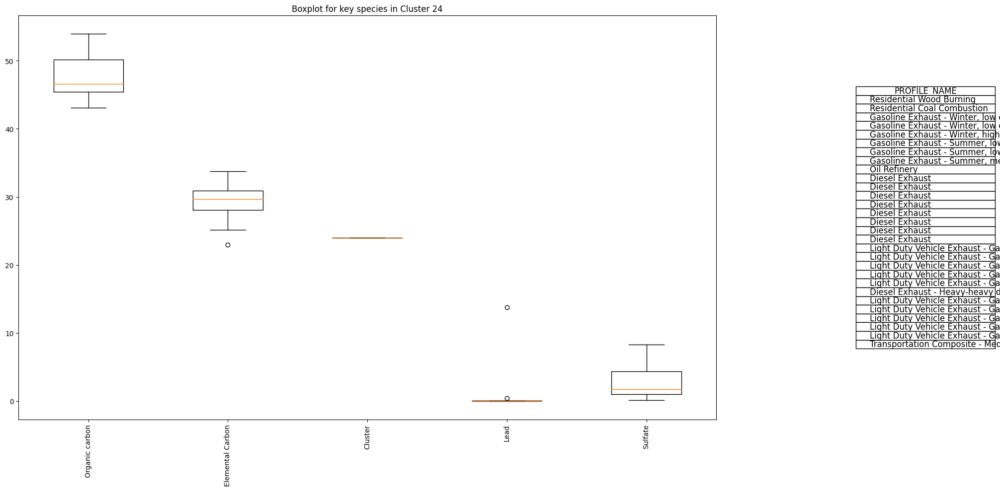

Important species for Cluster 25: ['Cluster', 'Organic carbon', 'Silicon', 'Titanium', 'Elemental Carbon']


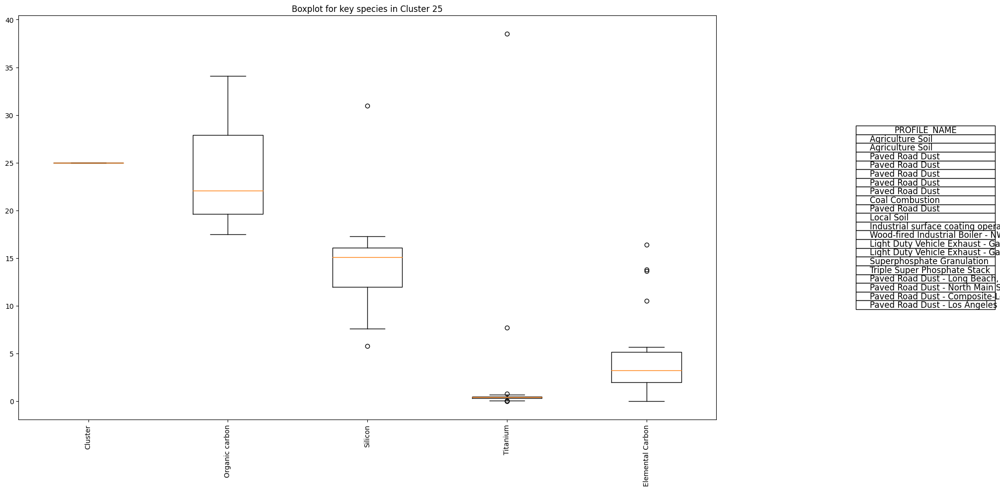

Important species for Cluster 26: ['Cluster', 'Silicon', 'Lead', 'Aluminum', 'Iron']


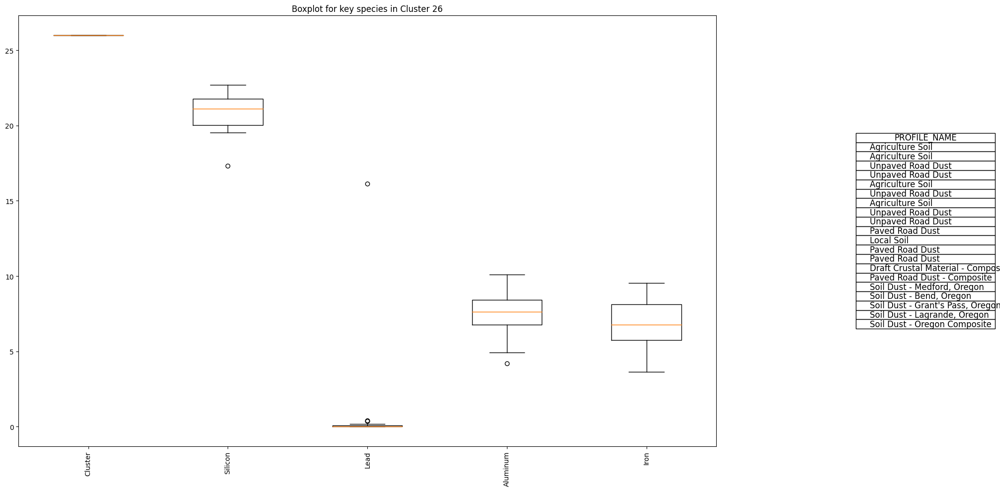

Important species for Cluster 27: ['Cluster', 'Silicon', 'Calcium', 'Organic carbon', 'Aluminum']


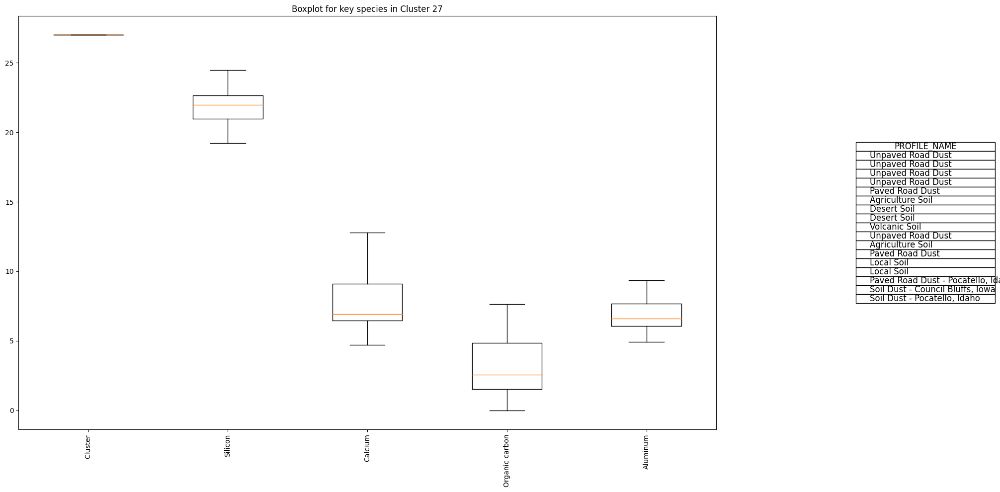

Important species for Cluster 28: ['Cluster', 'Silicon', 'Organic carbon', 'Iron', 'Aluminum']


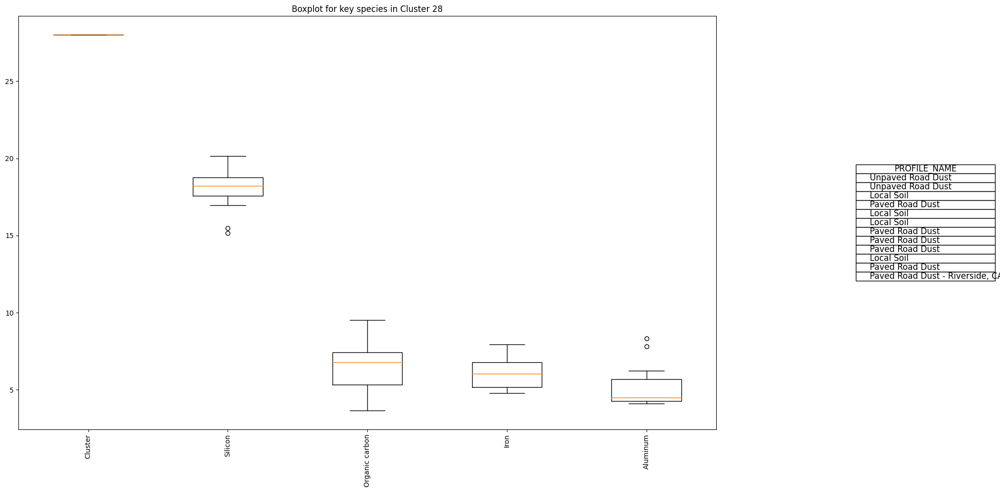

Important species for Cluster 29: ['Silicon', 'Cluster', 'Aluminum', 'Elemental Carbon', 'Sulfate']


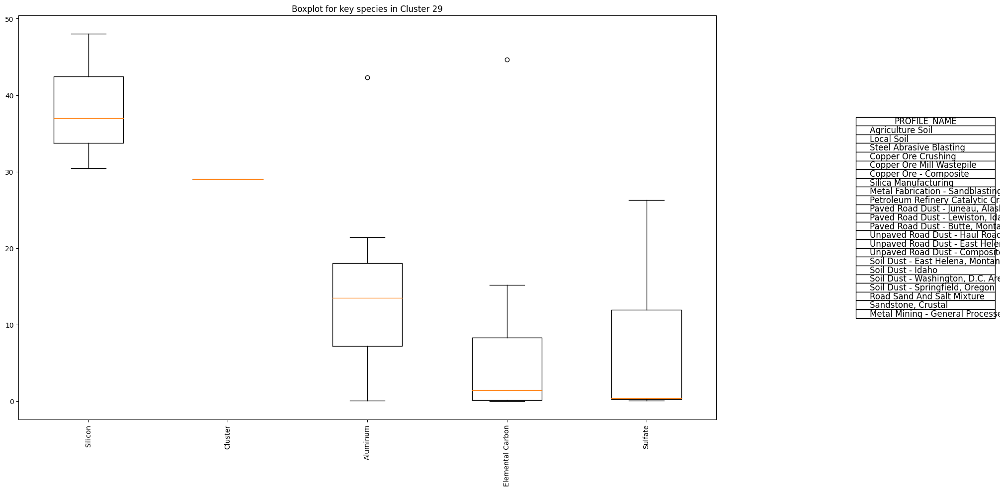

Important species for Cluster 30: ['Cluster', 'Silicon', 'Calcium', 'Aluminum', 'Sulfate']


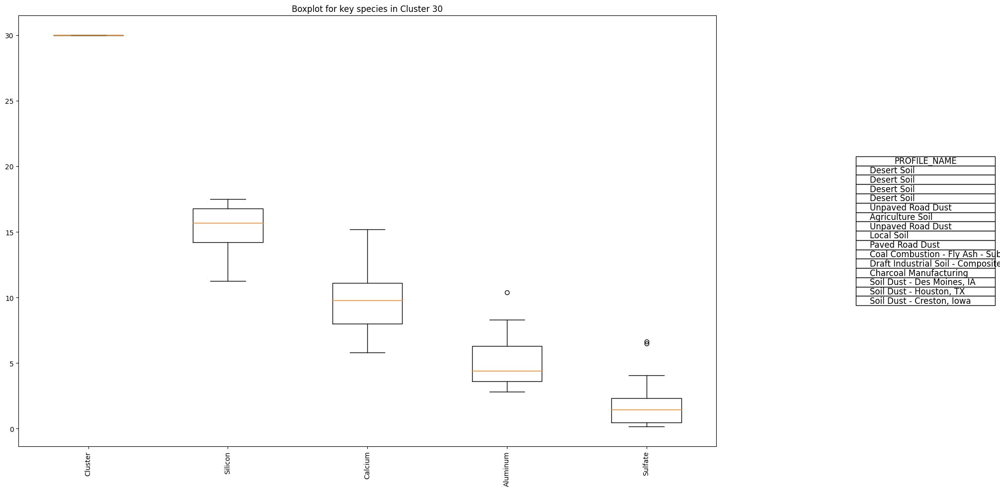

Important species for Cluster 31: ['Cluster', 'Silicon', 'Aluminum', 'Lead', 'Antimony']


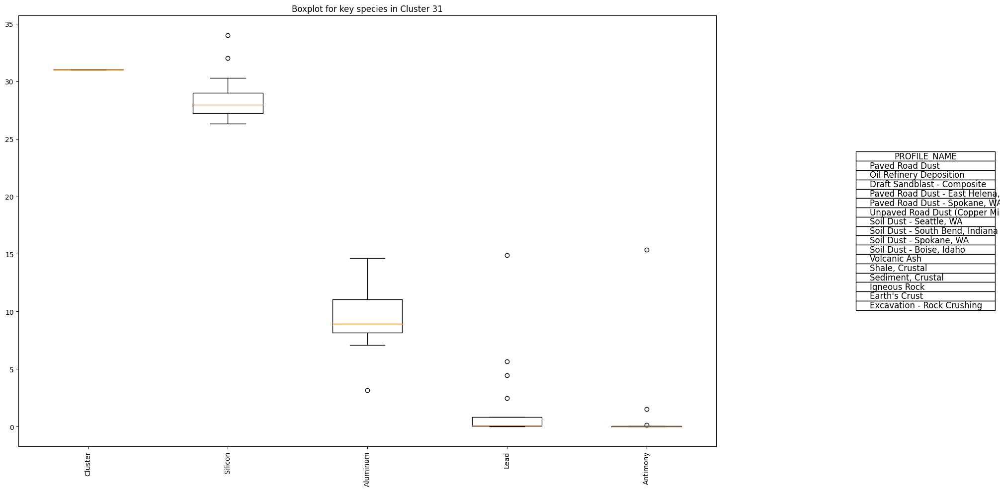

Important species for Cluster 32: ['Cluster', 'Calcium', 'Organic carbon', 'Silicon', 'Sulfate']


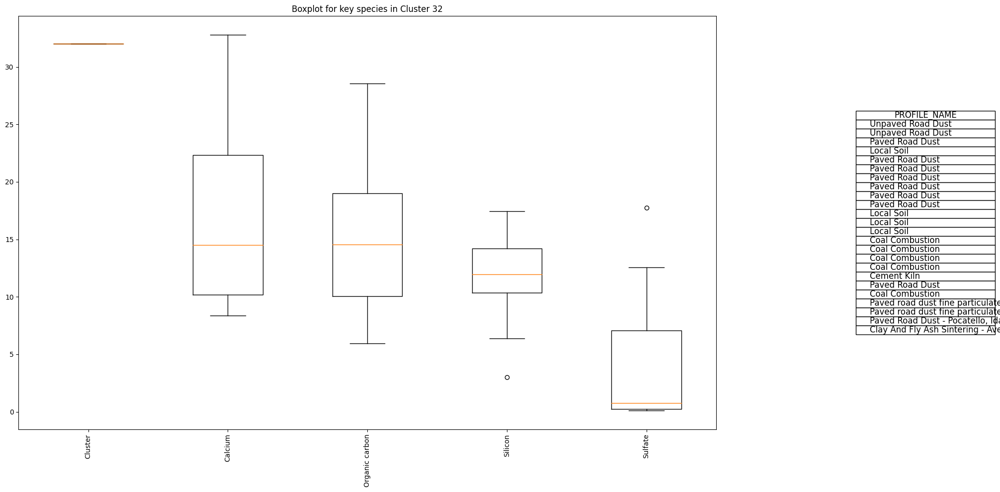

Important species for Cluster 33: ['Cluster', 'Organic carbon', 'Elemental Carbon', 'Nitrate', 'Potassium']


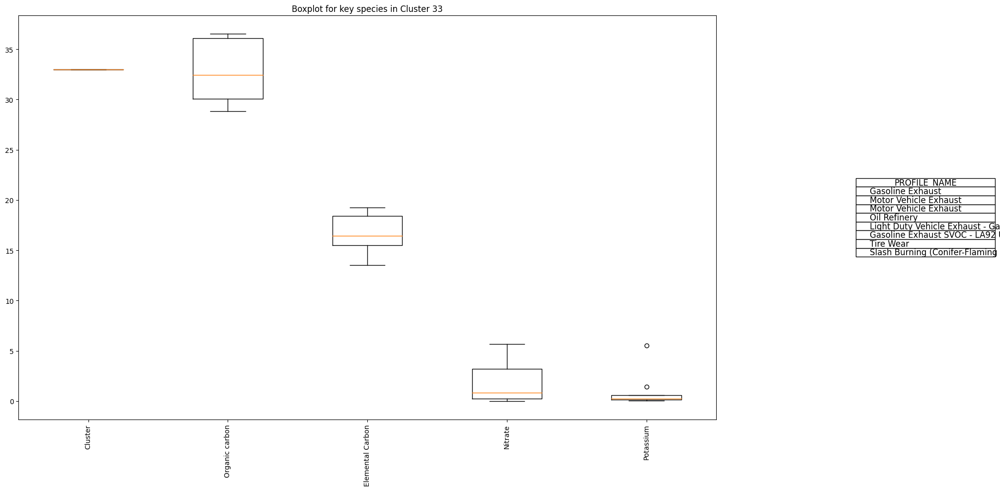

Important species for Cluster 34: ['Organic carbon', 'Elemental Carbon', 'Cluster', 'Nitrate', 'Lead']


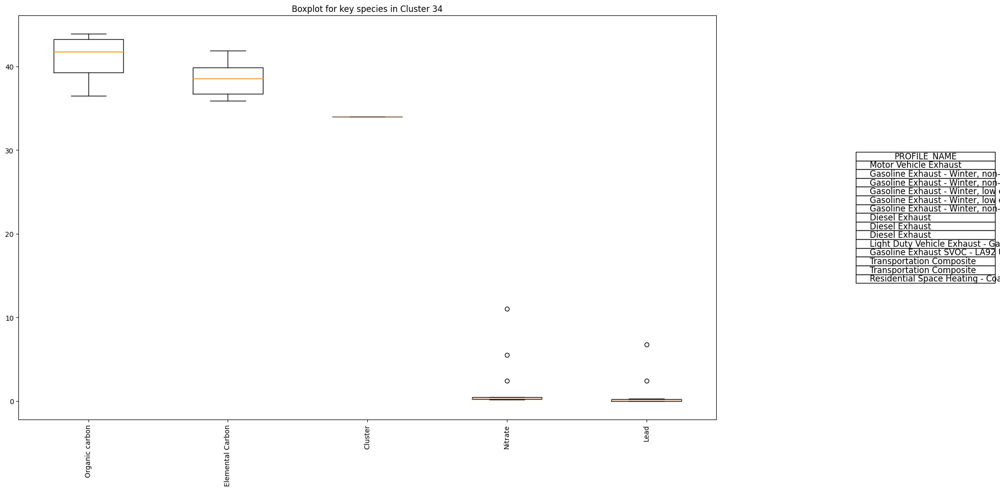

Important species for Cluster 35: ['Cluster', 'Sulfate', 'Iron', 'Elemental Carbon', 'Silicon']


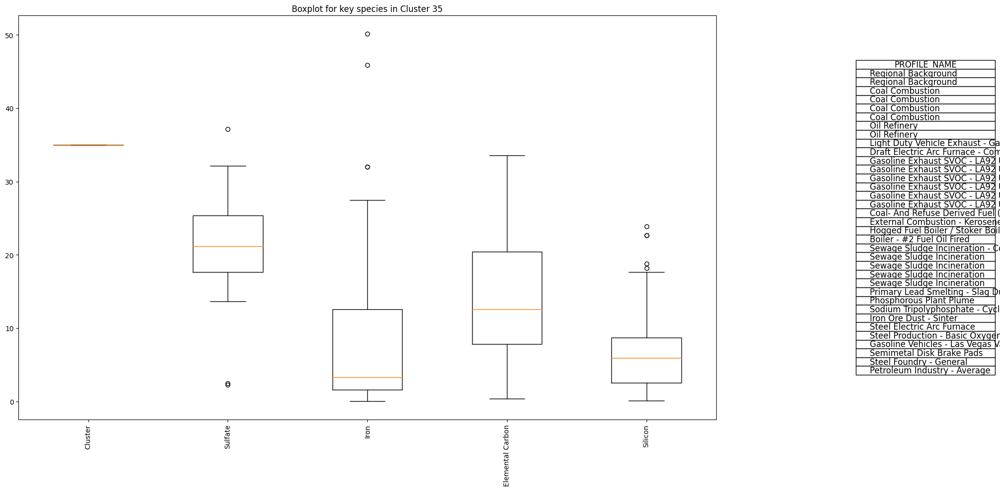

Important species for Cluster 36: ['Cluster', 'Calcium', 'Sulfate', 'Iron', 'Silicon']


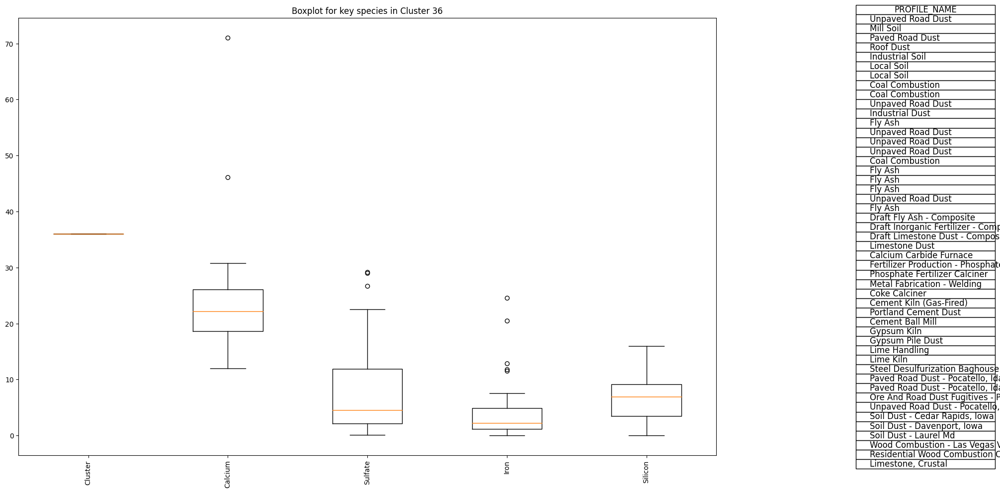

Important species for Cluster 37: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Lead', 'Chloride ion']


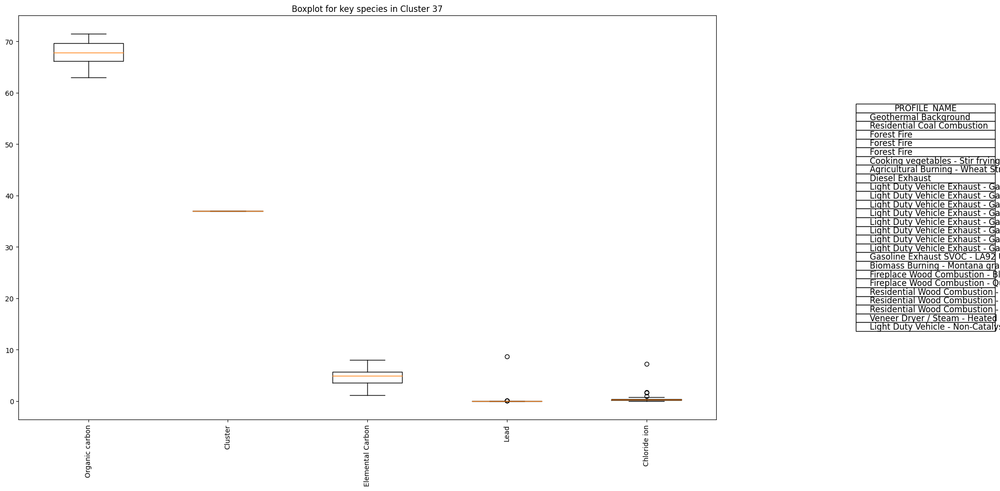

Important species for Cluster 38: ['Chloride ion', 'Cluster', 'Sulfate', 'Calcium', 'Organic carbon']


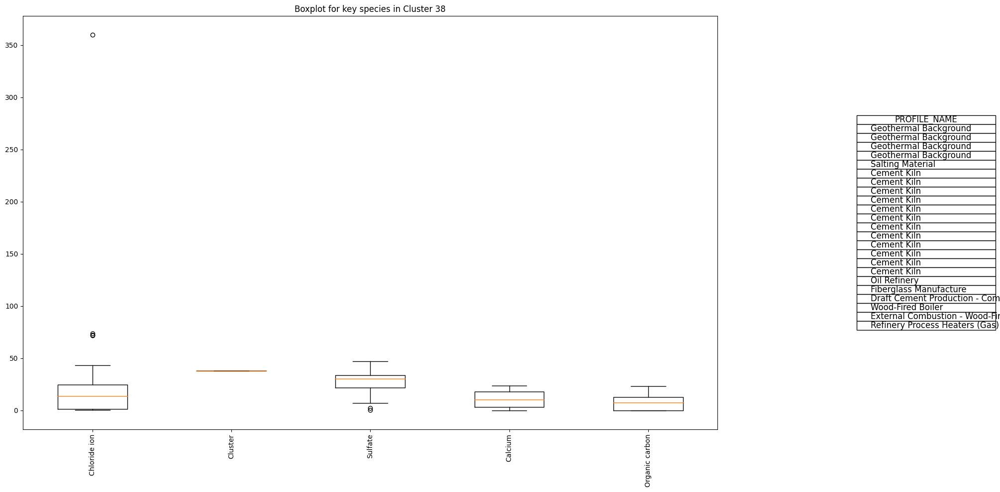

Important species for Cluster 39: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Sodium', 'Sulfate']


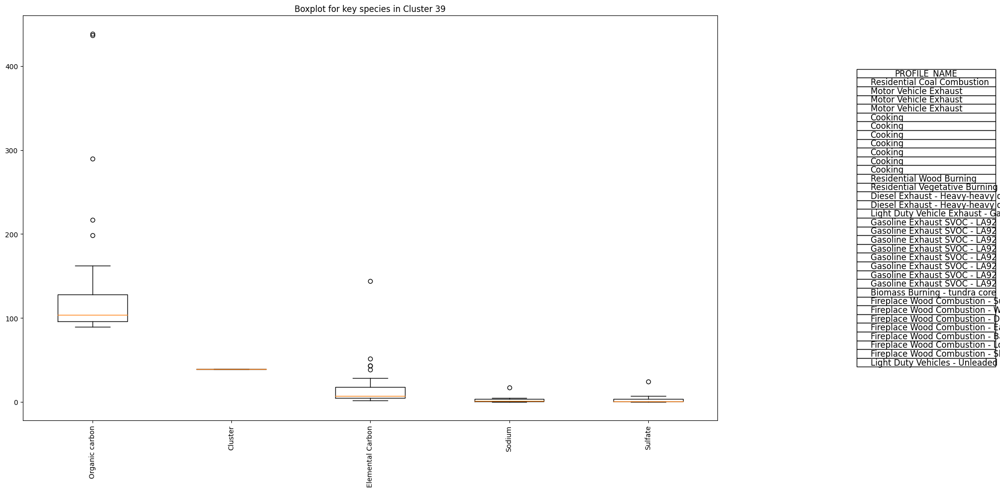

Important species for Cluster 40: ['Elemental Carbon', 'Cluster', 'Organic carbon', 'Potassium', 'Chloride ion']


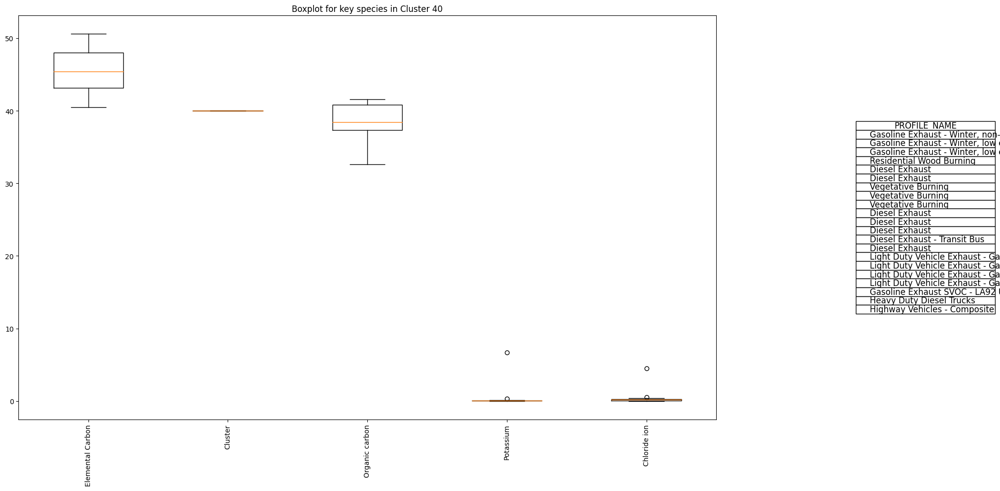

Important species for Cluster 41: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Chloride ion', 'Potassium ion']


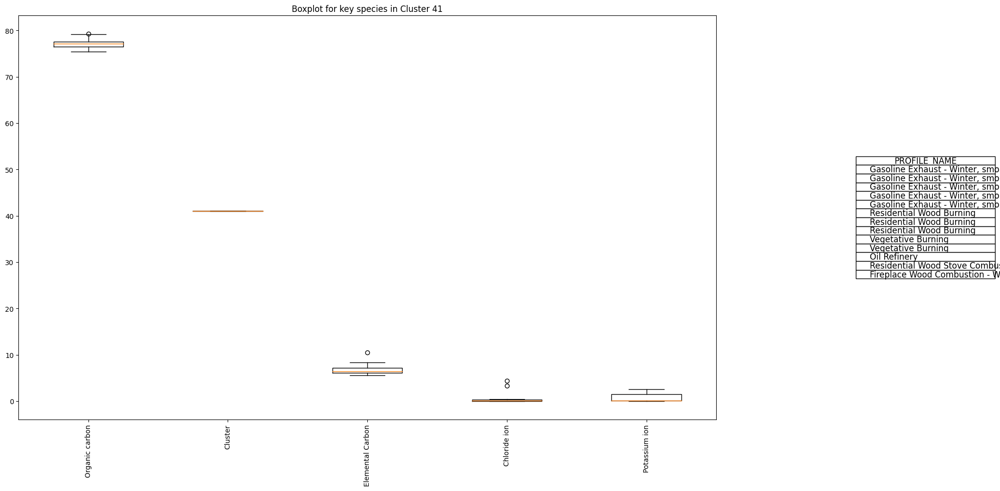

Important species for Cluster 42: ['Elemental Carbon', 'Cluster', 'Organic carbon', 'Potassium', 'Sulfate']


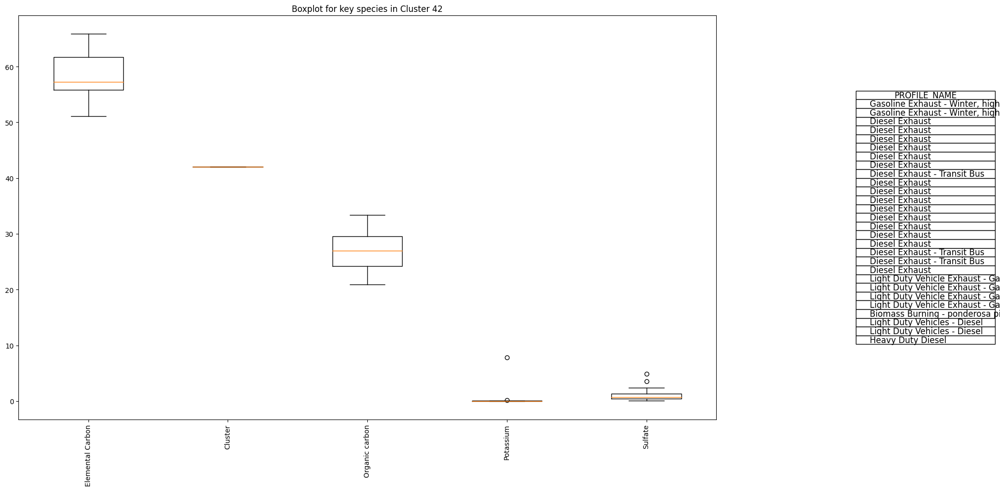

Important species for Cluster 43: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Lead', 'Potassium']


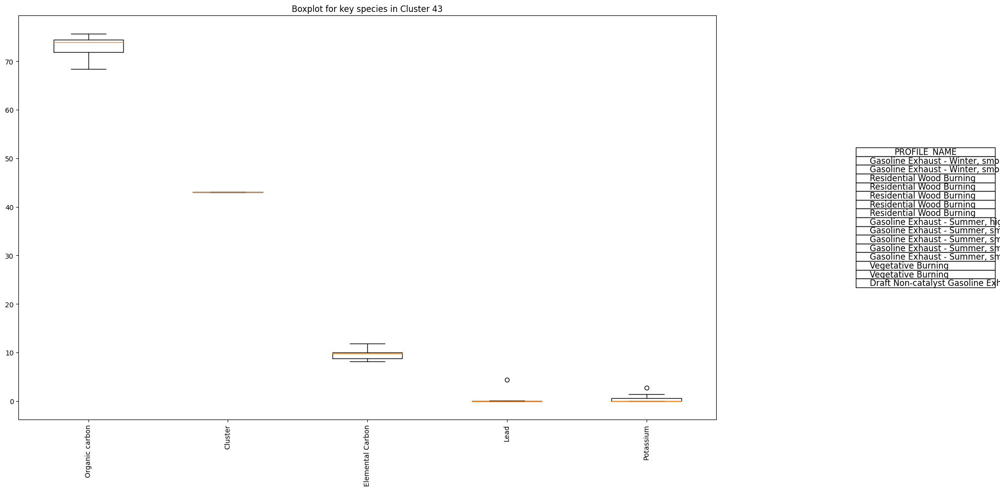

Important species for Cluster 44: ['Organic carbon', 'Cluster', 'Elemental Carbon', 'Chloride ion', 'Potassium']


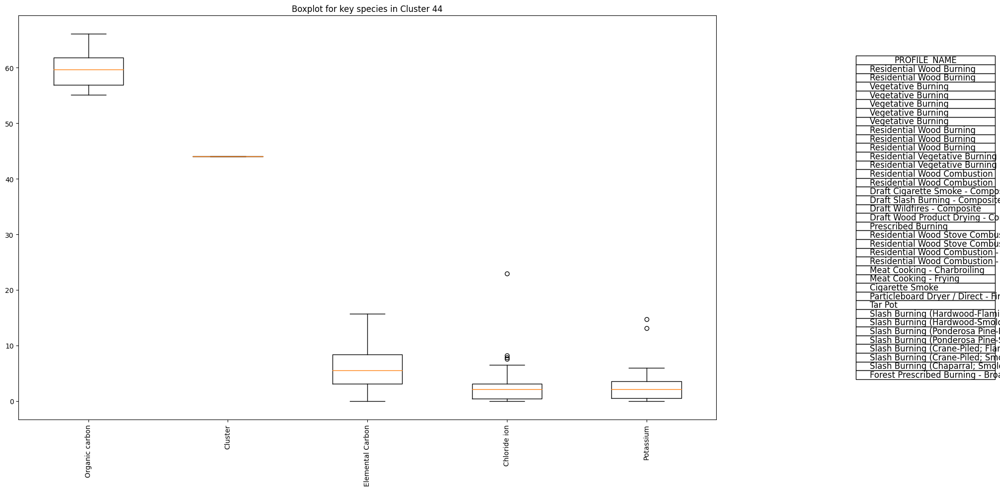

Important species for Cluster 45: ['Organic carbon', 'Cluster', 'Calcium', 'Elemental Carbon', 'Sulfate']


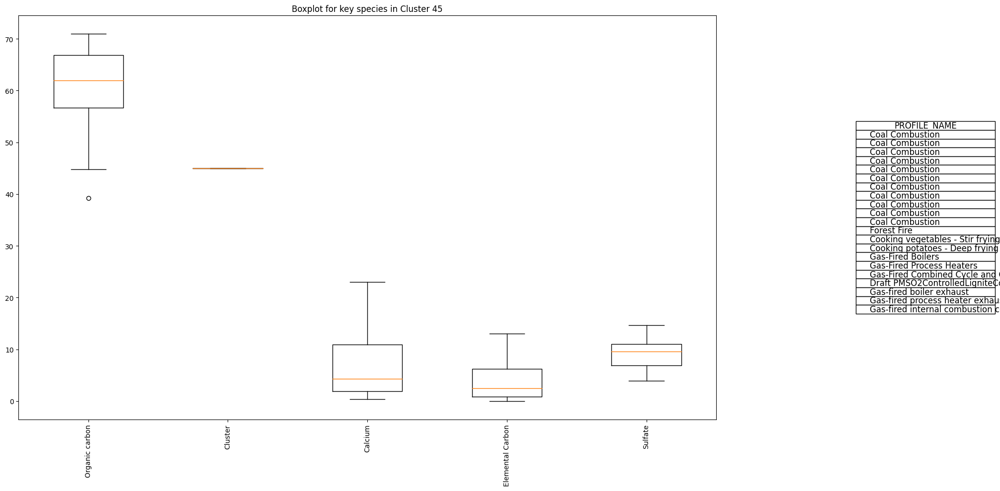

Important species for Cluster 46: ['Sulfate', 'Cluster', 'Sulfur', 'Organic carbon', 'Calcium']


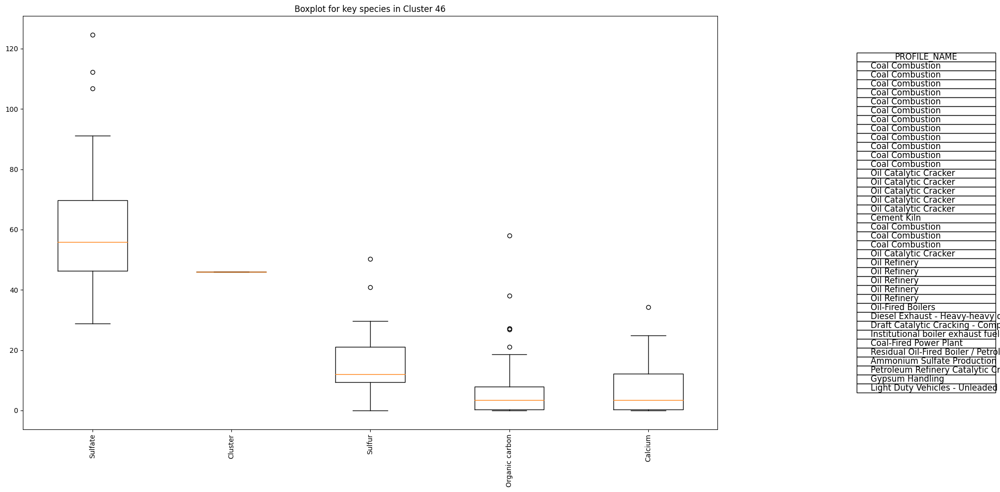

Important species for Cluster 47: ['Cluster', 'Sulfate', 'Sodium', 'Potassium ion', 'Potassium']


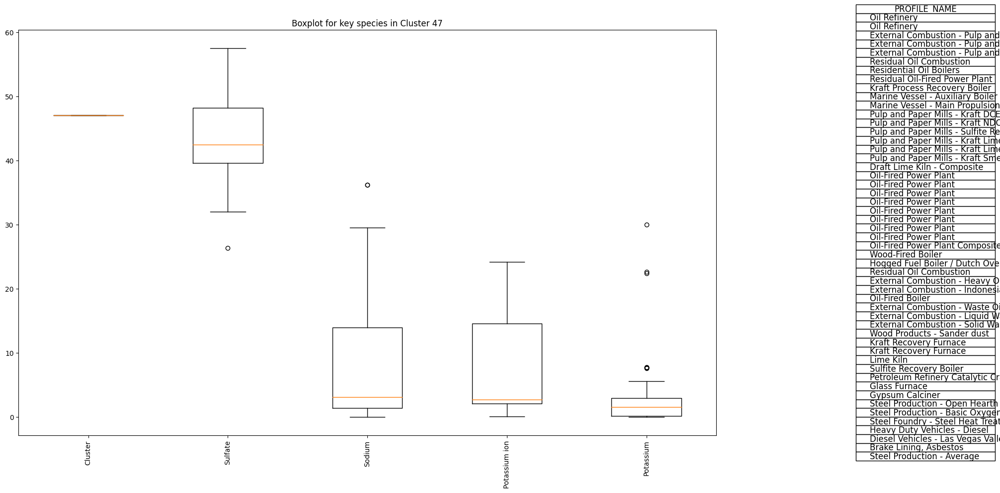

Important species for Cluster 48: ['Cluster', 'Arsenic', 'Zinc', 'Lead', 'Sulfate']


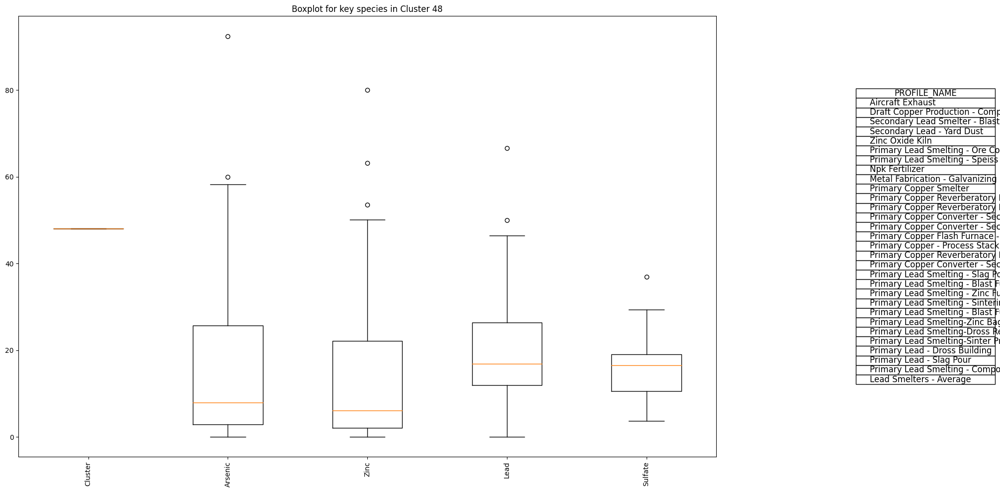

Important species for Cluster 49: ['Elemental Carbon', 'Cluster', 'Sulfate', 'Organic carbon', 'Silicon']


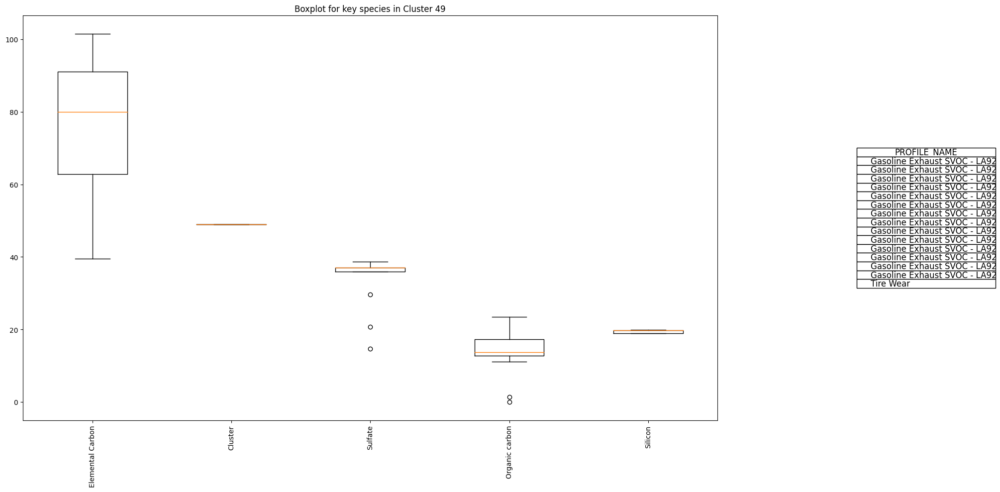

Important species for Cluster 50: ['Cluster', 'Elemental Carbon', 'Sulfate', 'Zinc', 'Lead']


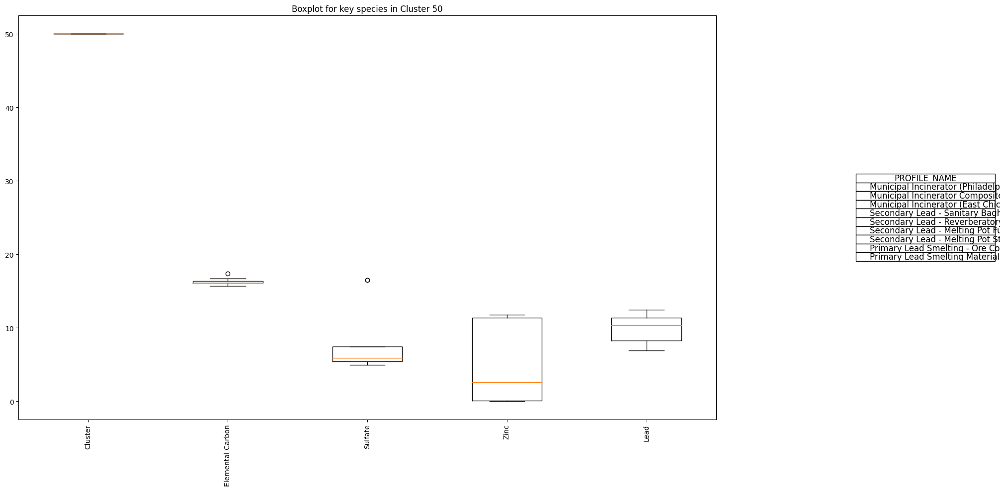

Important species for Cluster 51: ['Cluster', 'Iron', 'Copper', 'Sulfate', 'Silicon']


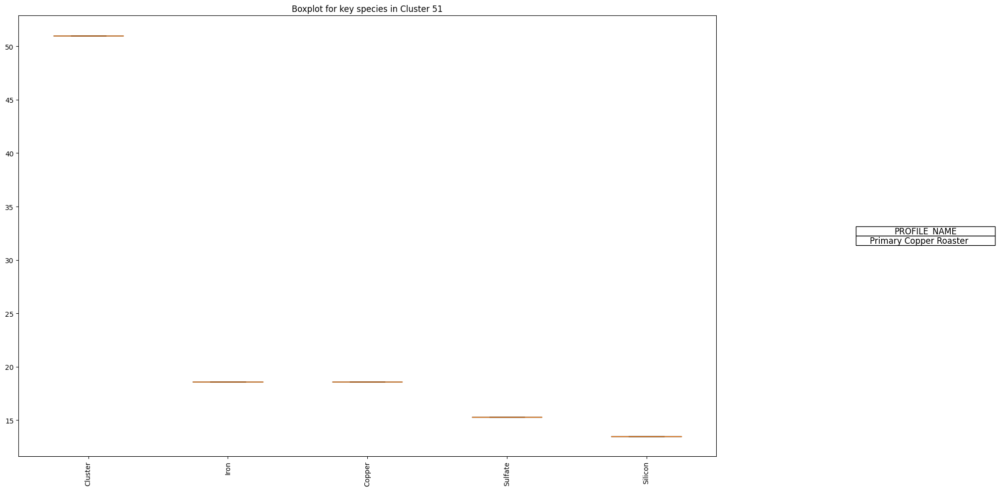

In [43]:
# Number of top important species to display
k_species = 5

# Get the unique cluster numbers
unique_clusters = df['Cluster'].unique()

for cluster_num in sorted(unique_clusters):
    # Get rows belonging to this cluster
    cluster_rows = df[df['Cluster'] == cluster_num]

    # Skip if no rows found (or handle NaN clusters)
    if cluster_rows.empty:
        continue

    # Select species-related columns; adjust the column indices as needed.
    # Here, we assume the species data is stored in all columns starting from index 6.
    species_data = cluster_rows.iloc[:, 6:]

    # Compute SVD on the species data matrix (ensure the data is numeric)
    U, S, Vt = np.linalg.svd(species_data, full_matrices=False)

    # Calculate column importance using the SVD components.
    # We square Vt, weight by the singular values and sum along the rows to aggregate importance.
    column_importance = np.sum(np.matmul(np.diag(S), Vt**2), axis=0)

    # Identify the indices of the top k important species
    important_columns_indices = np.argsort(-column_importance)[:k_species]

    # Get the corresponding column names
    important_columns = species_data.columns[important_columns_indices]

    print(f"Important species for Cluster {cluster_num}: {list(important_columns)}")

    # Create a figure and axes for the boxplot
    fig, ax = plt.subplots(figsize=(20, 10))

    # Create the boxplot using only the key species
    ax.boxplot(cluster_rows[important_columns])
    ax.grid(False)
    ax.set_xticklabels(important_columns, rotation=90)
    plt.title(f"Boxplot for key species in Cluster {cluster_num}")

    # Create a divider for the existing axes instance to add a table on the right
    divider = make_axes_locatable(ax)
    ax_table = divider.append_axes("right", size="20%", pad=0.0)
    ax_table.axis("off")

    # Create the table using the PROFILE_NAME column (adjust the column name if needed)
    table_data = cluster_rows[['PROFILE_NAME']]
    table = ax_table.table(
        cellText=table_data.values,
        colLabels=table_data.columns,
        cellLoc='left',
        loc='right'
    )
    table.auto_set_font_size(False)
    table.set_fontsize(12)
#     table.scale(2, 2)

    plt.tight_layout()
    plt.show()
